参考：
https://tianchi.aliyun.com/notebook-ai/detail?spm=5176.12586969.1002.3.3f9274ffPqC5l9&postId=41563

In [1]:
# 抑制警告
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['figure.max_open_warning'] = 0
plt.rcParams['figure.dpi'] = 200
import seaborn as sns

from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV, RepeatedKFold, cross_val_score, cross_val_predict, KFold
from sklearn.metrics import make_scorer, mean_squared_error
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.svm import LinearSVR, SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.preprocessing import PolynomialFeatures, MinMaxScaler, StandardScaler

In [2]:
# 加载数据
rootdir = 'D:/Project/04 tianchi/01 dataset/zhengqi prediction/'
with open(rootdir+'zhengqi_train.txt') as zq_train:
    data_train = pd.read_table(zq_train, sep='\t')
with open(rootdir+'zhengqi_test.txt') as zq_test:
    data_test = pd.read_table(zq_test, sep='\t')

In [3]:
# 合并训练集和测试集
data_train['origin'] = 'train'
data_test['origin'] = 'test'

data_all = pd.concat([data_train, data_test], axis=0, ignore_index=True)

print(data_all.shape)
data_all.head()

(4813, 40)


,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V30,V31,V32,V33,V34,V35,V36,V37,target,origin
0,0.566,0.016,-0.143,0.407,0.452,-0.901,-1.812,-2.360,-0.436,-2.114,...,0.109,-0.615,0.327,-4.627,-4.789,-5.101,-2.608,-3.508,0.175,train
1,0.968,0.437,0.066,0.566,0.194,-0.893,-1.566,-2.360,0.332,-2.114,...,0.124,0.032,0.600,-0.843,0.160,0.364,-0.335,-0.730,0.676,train
2,1.013,0.568,0.235,0.370,0.112,-0.797,-1.367,-2.360,0.396,-2.114,...,0.361,0.277,-0.116,-0.843,0.160,0.364,0.765,-0.589,0.633,train
3,0.733,0.368,0.283,0.165,0.599,-0.679,-1.200,-2.086,0.403,-2.114,...,0.417,0.279,0.603,-0.843,-0.065,0.364,0.333,-0.112,0.206,train
4,0.684,0.638,0.260,0.209,0.337,-0.454,-1.073,-2.086,0.314,-2.114,...,1.078,0.328,0.418,-0.843,-0.215,0.364,-0.280,-0.028,0.384,train


In [4]:
data_all.columns

Index(['V0', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30',
       'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'target', 'origin'],
      dtype='object')

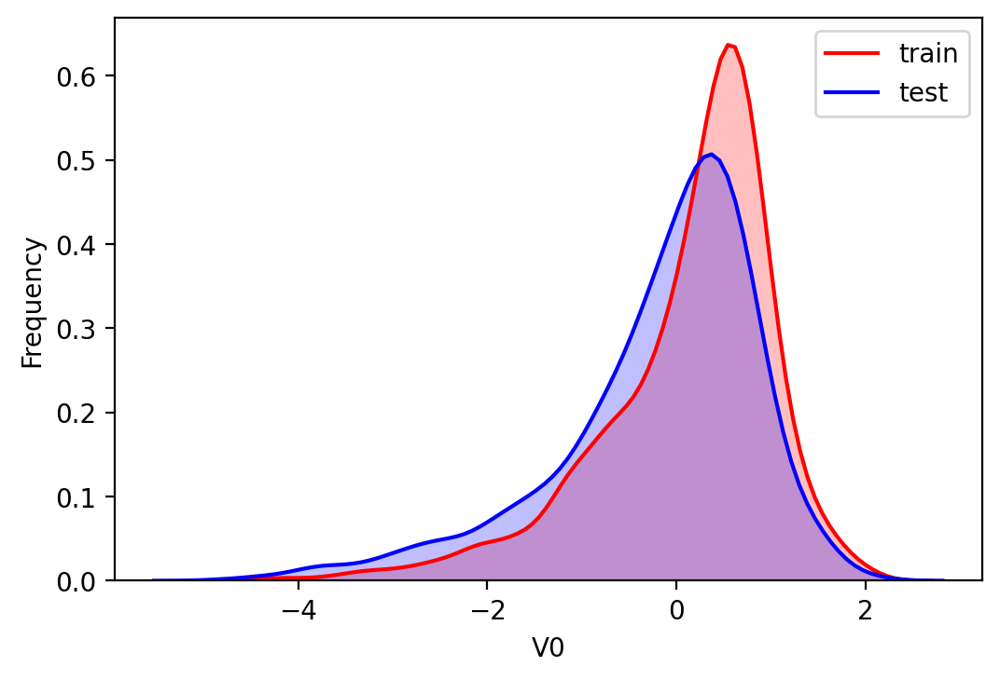

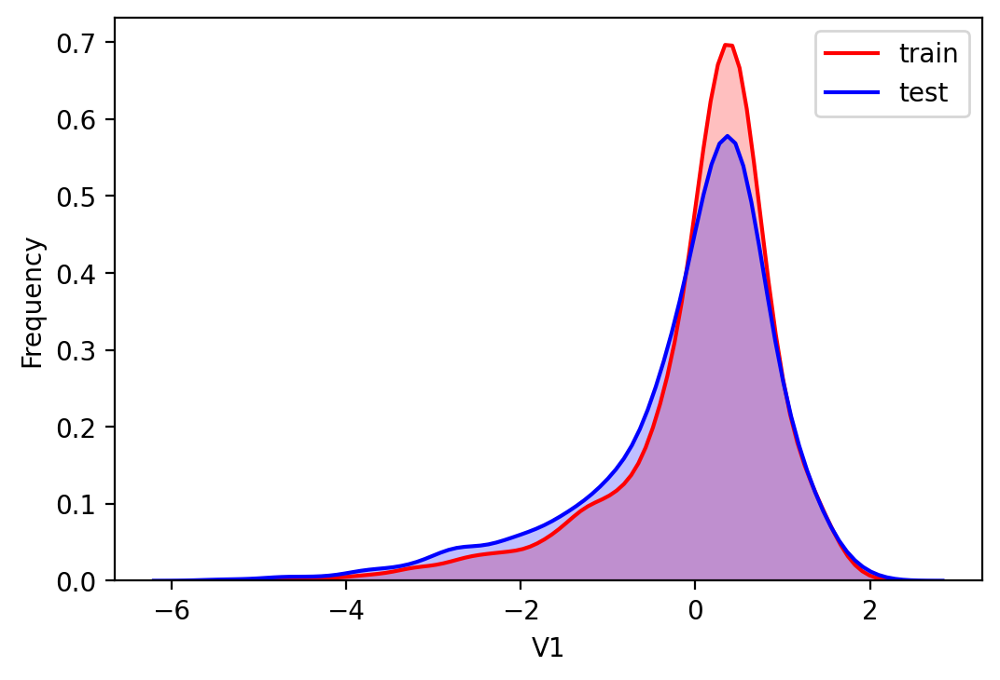

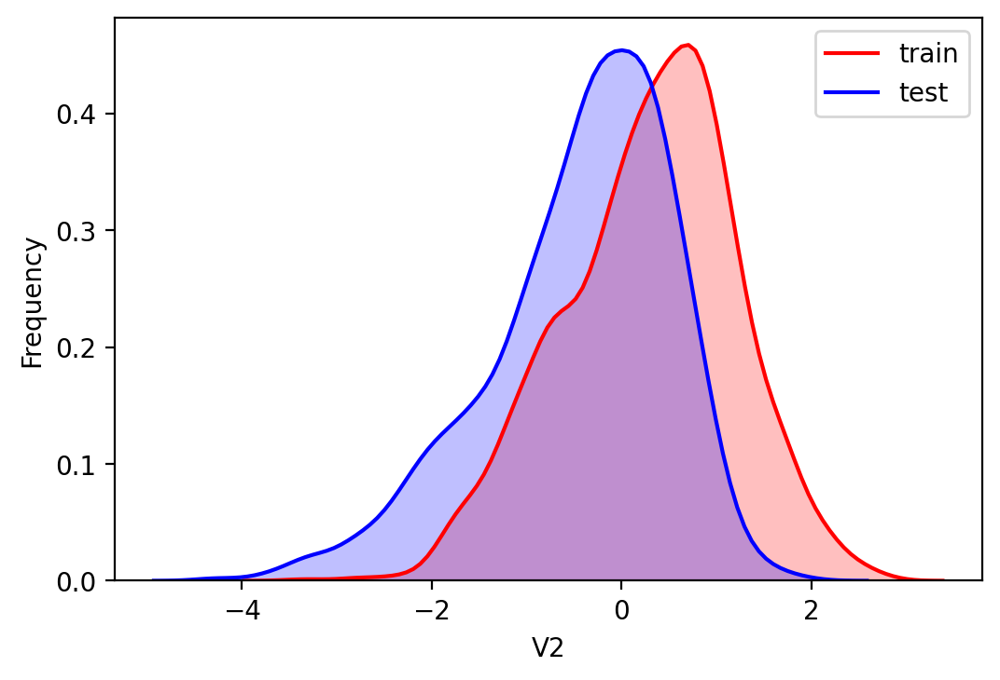

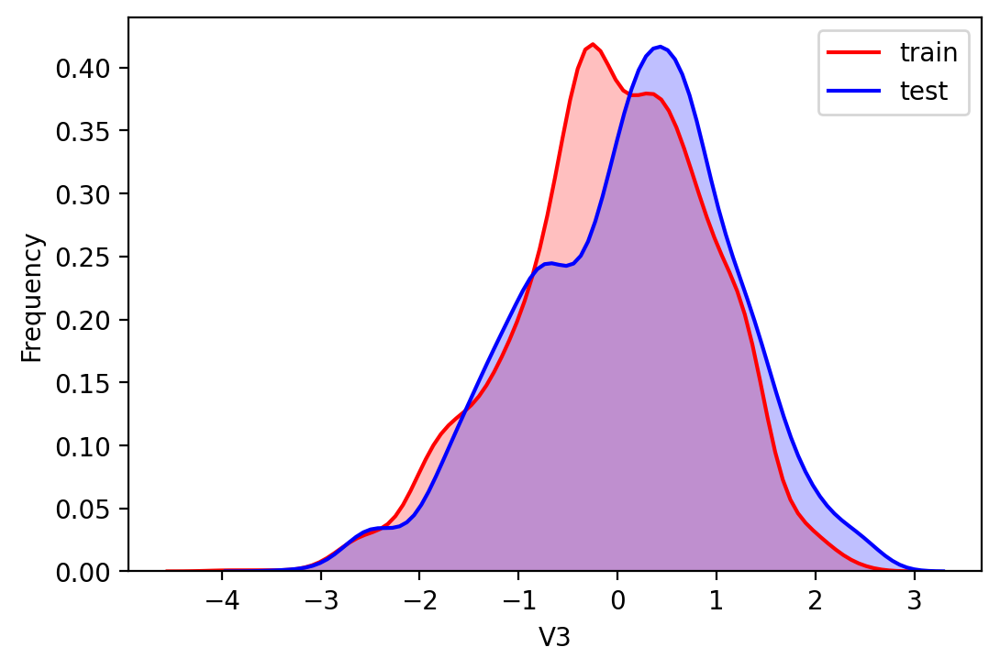

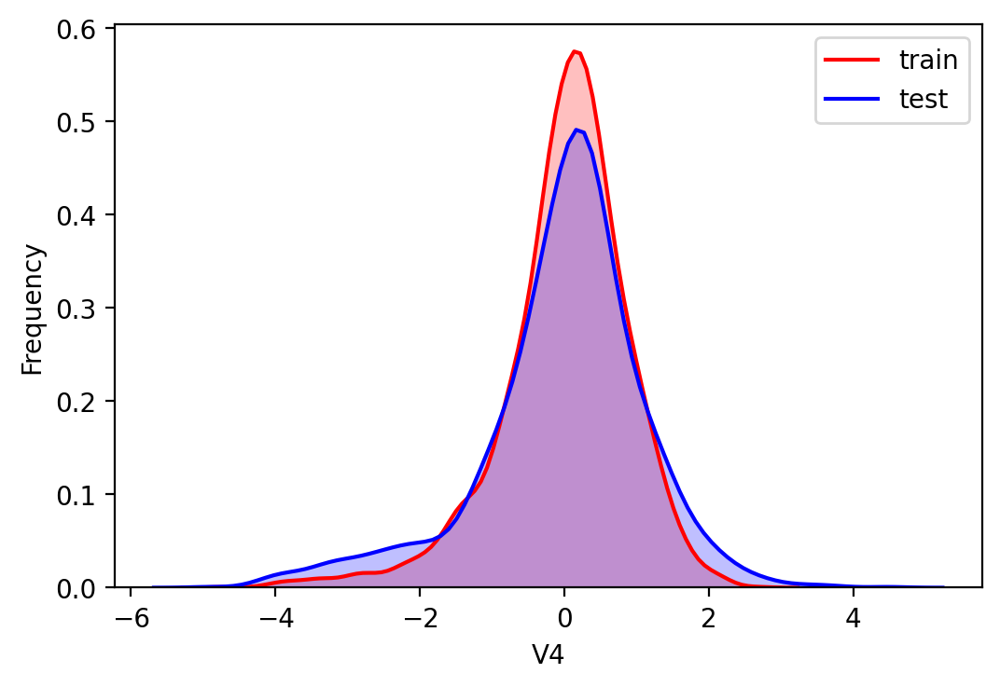

...

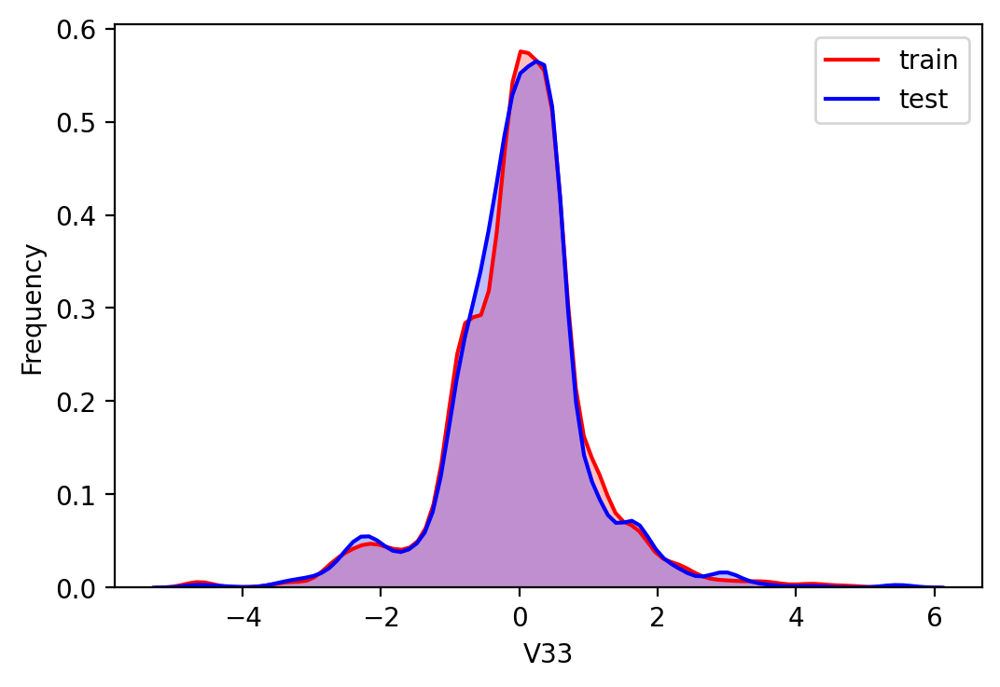

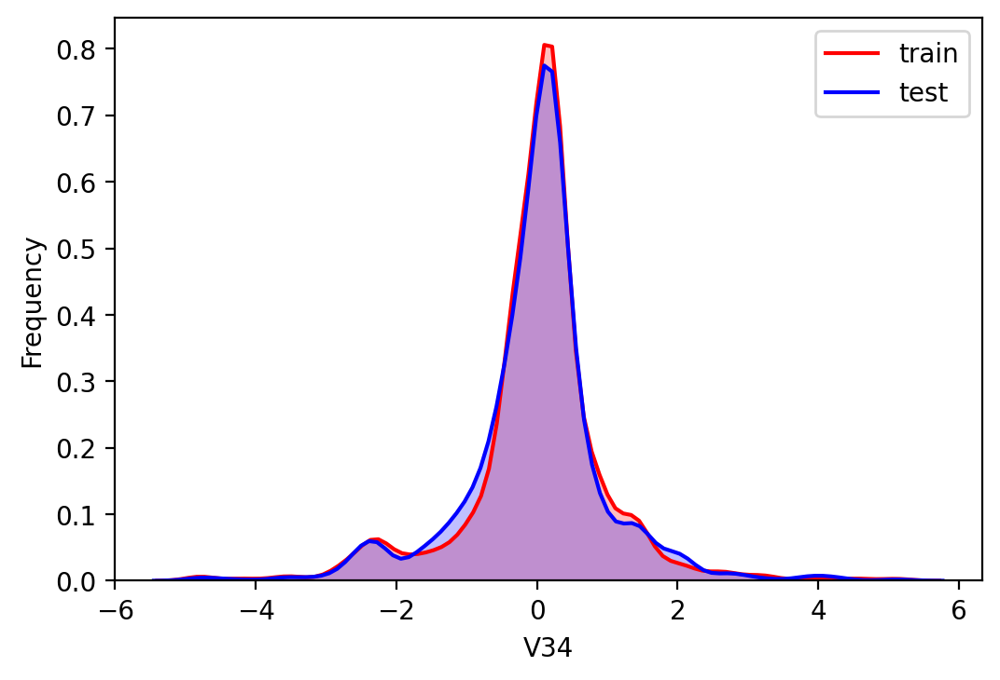

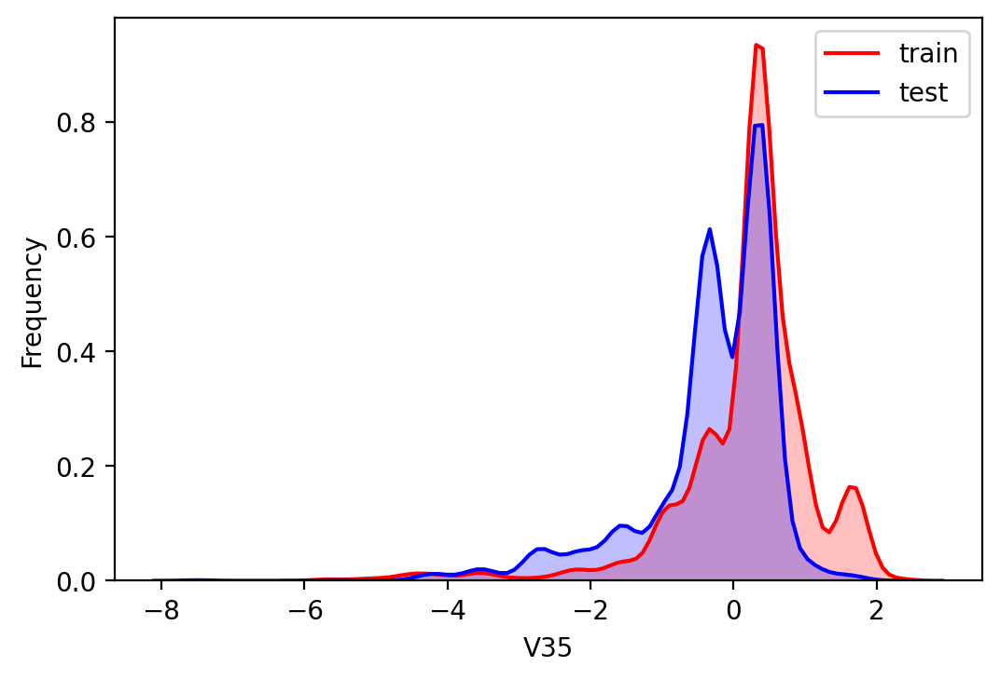

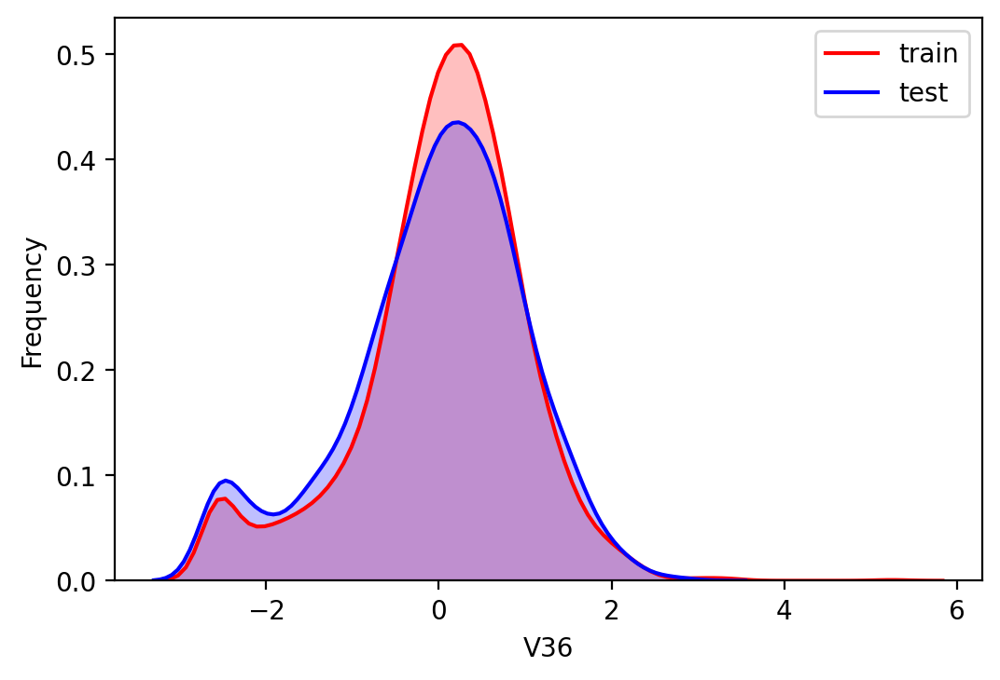

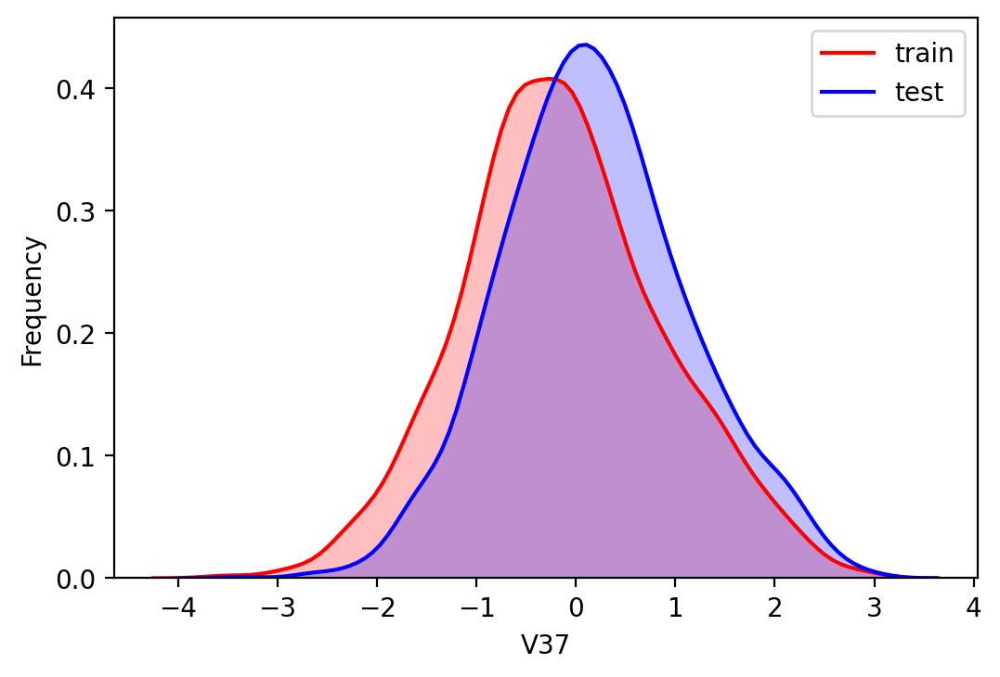

In [5]:
# 查看数据分布
for i,column in enumerate(data_all.columns[0:-2]):
    # 绘制密度图
    g = sns.kdeplot(data_all[column][(data_all["origin"] == "train")], color="Red", shade = True)
    g = sns.kdeplot(data_all[column][(data_all["origin"] == "test")], ax = g, color="Blue", shade= True)
    
    g.set_xlabel(column)
    g.set_ylabel("Frequency")
    g = g.legend(["train","test"])
    
    plt.show()

<Figure size 2000x2000 with 0 Axes>

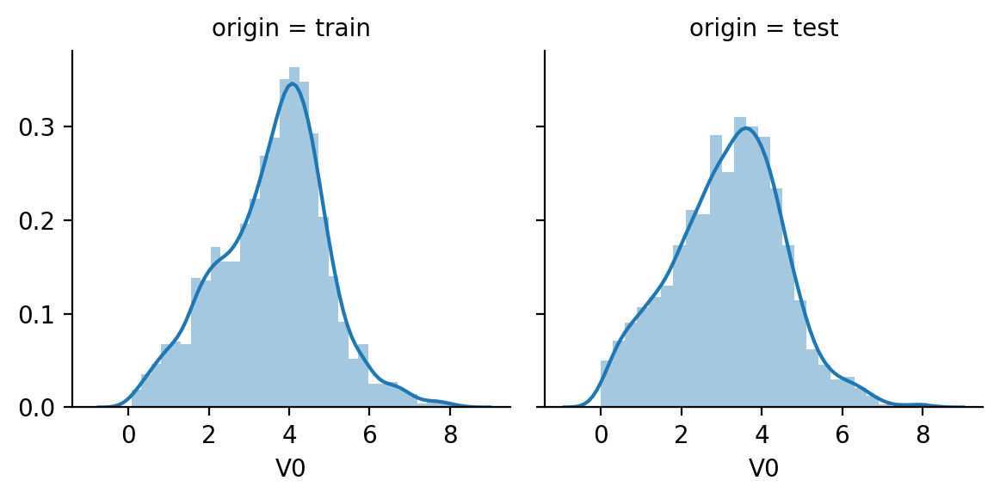

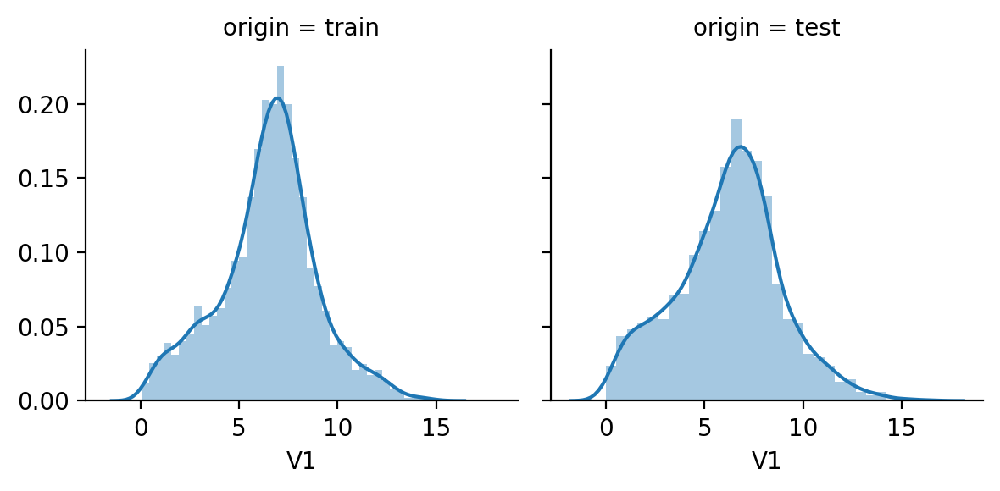

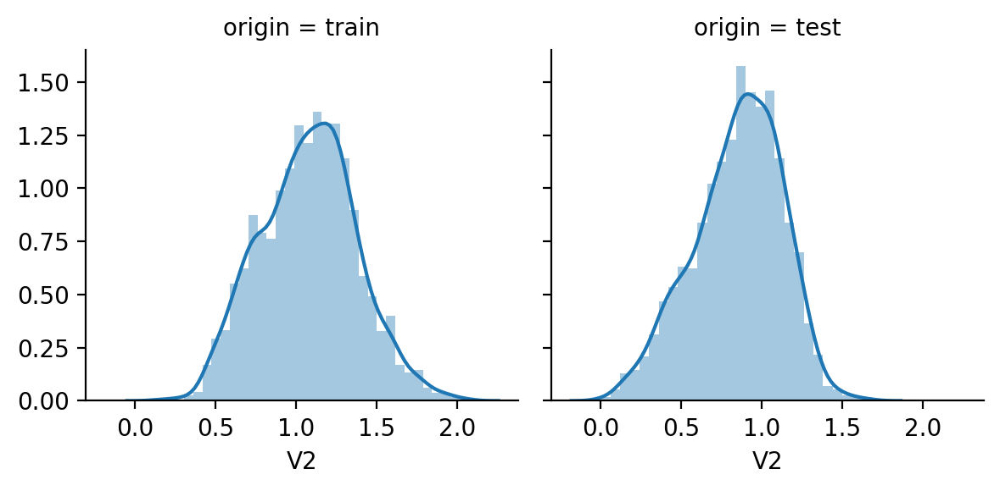

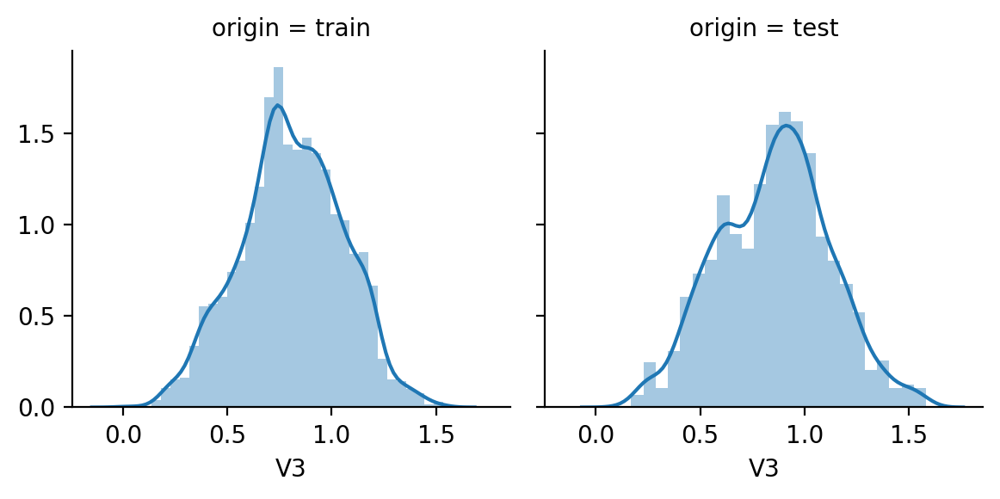

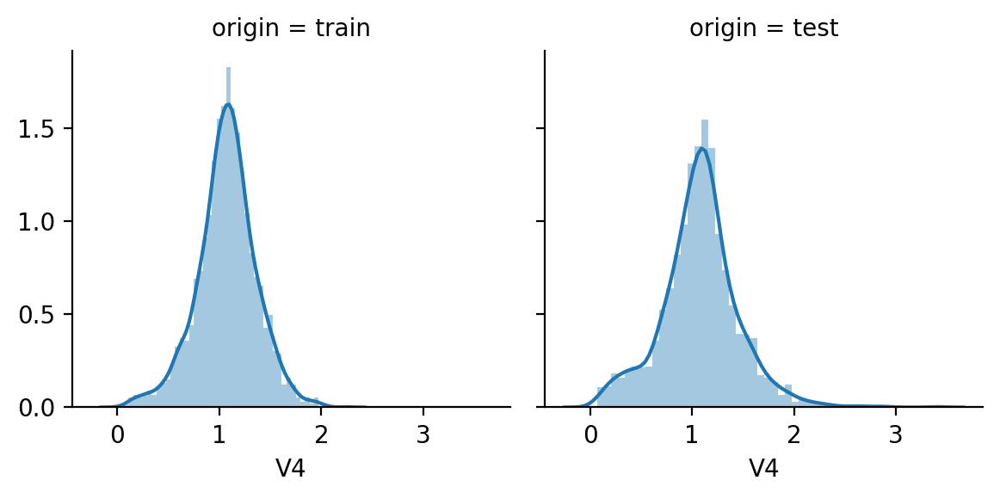

...

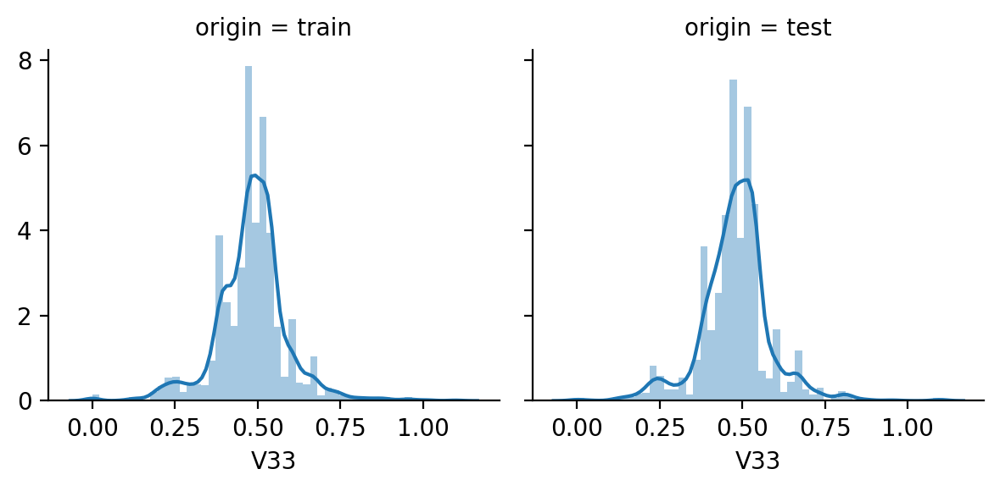

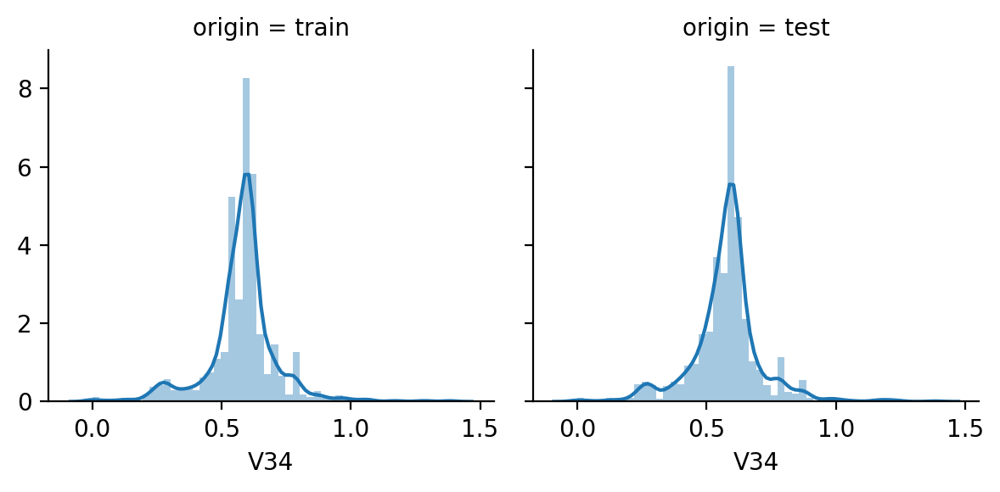

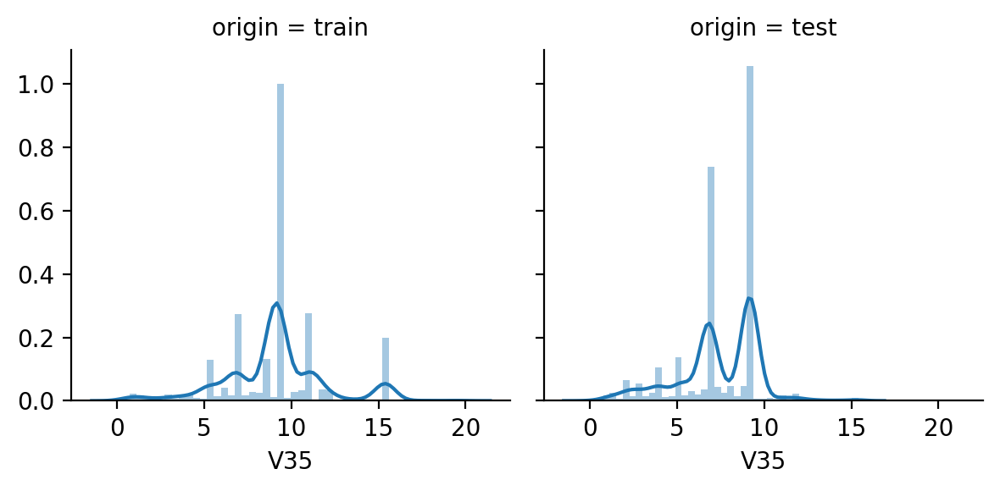

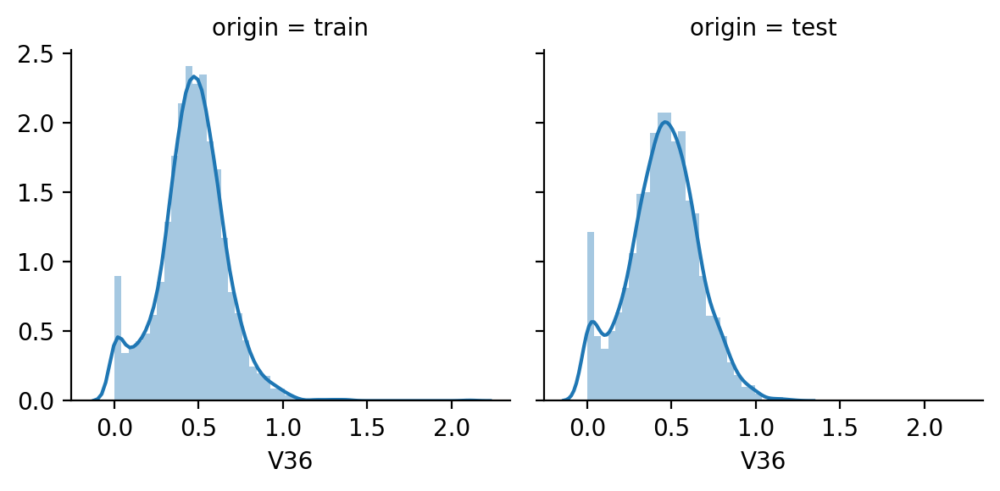

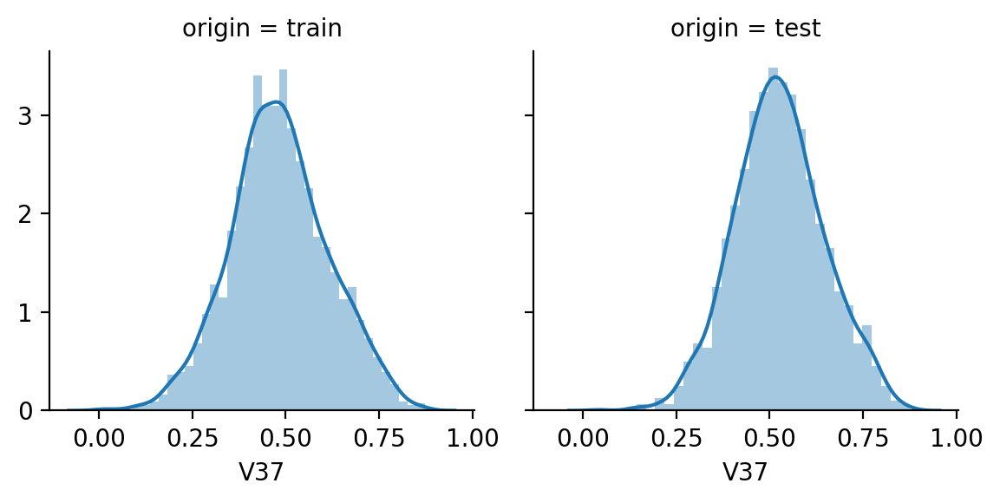

In [68]:
fig = plt.figure(figsize=(10, 10))
for i in range(len(data_all.columns)-2):
    # 设置图标矩阵
    g = sns.FacetGrid(data_all, col='origin')
    g = g.map(sns.distplot, data_all.columns[i])

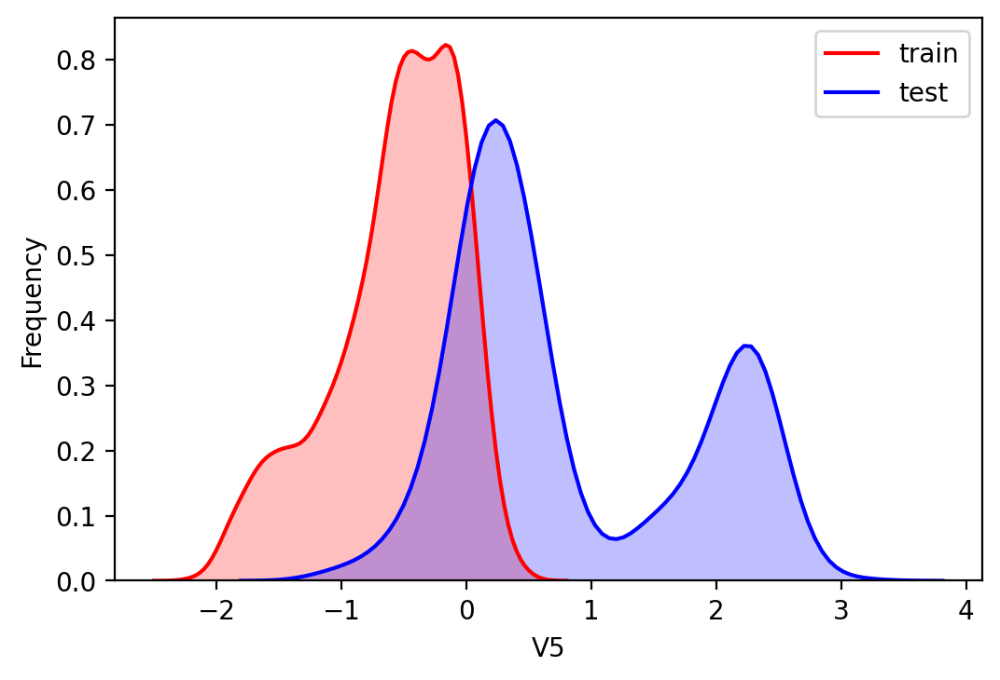

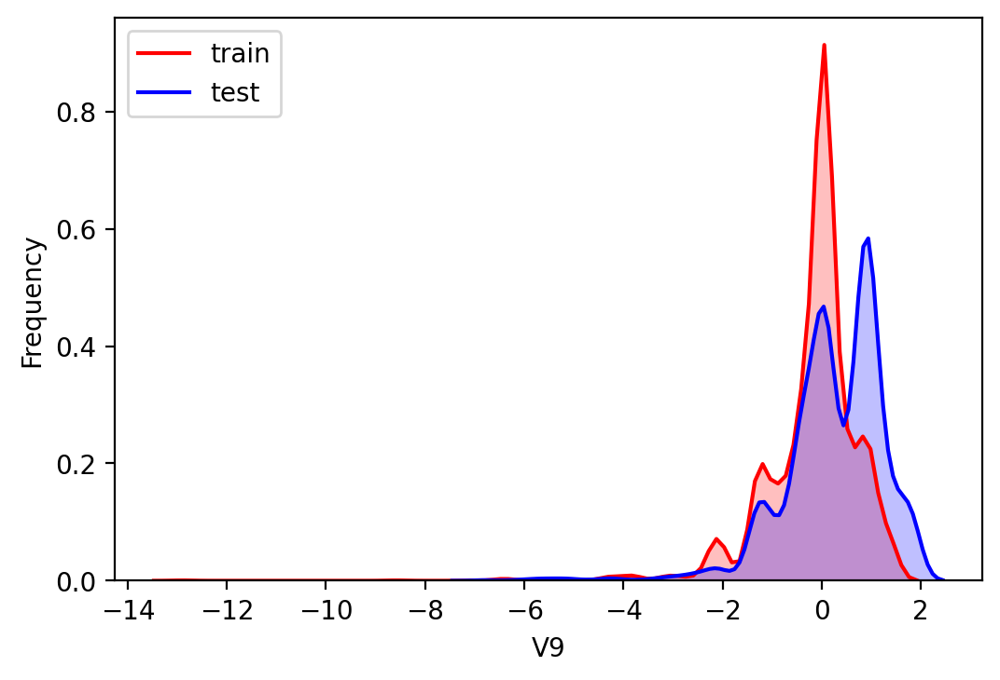

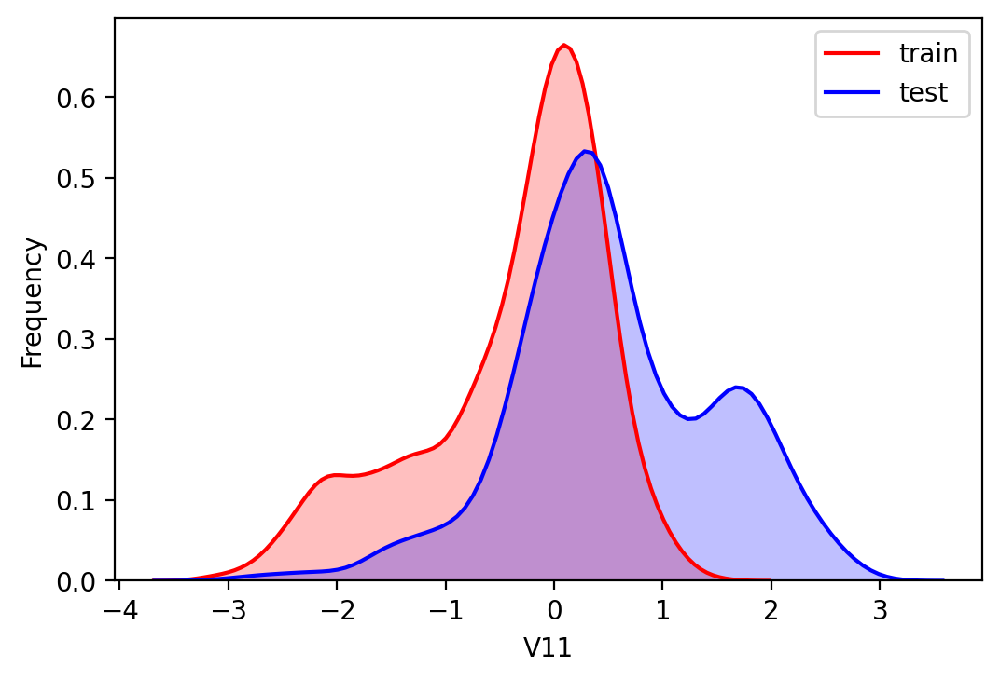

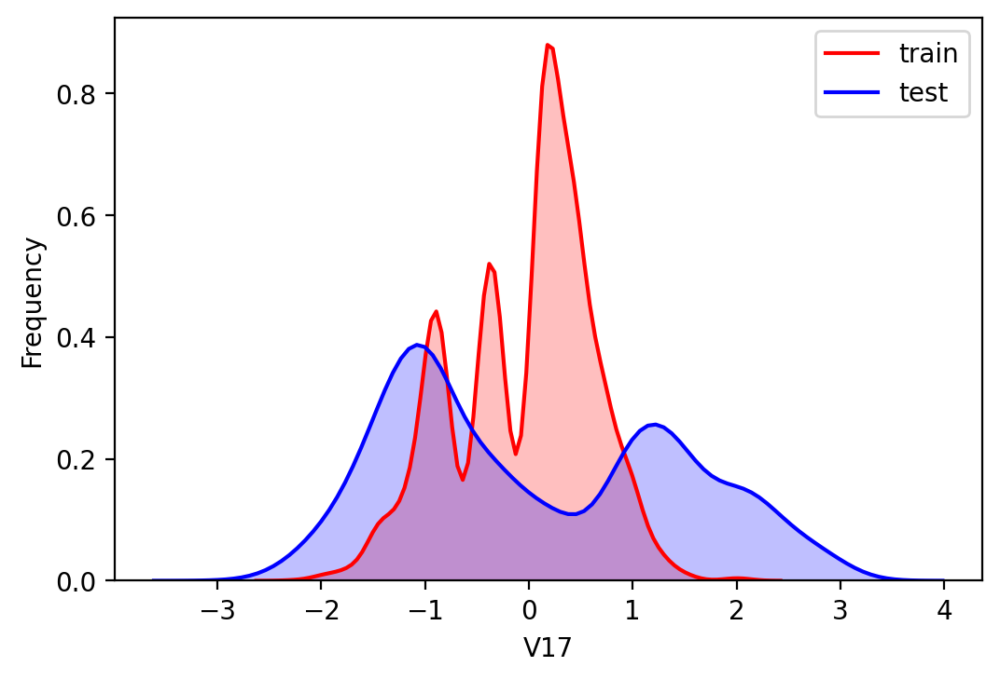

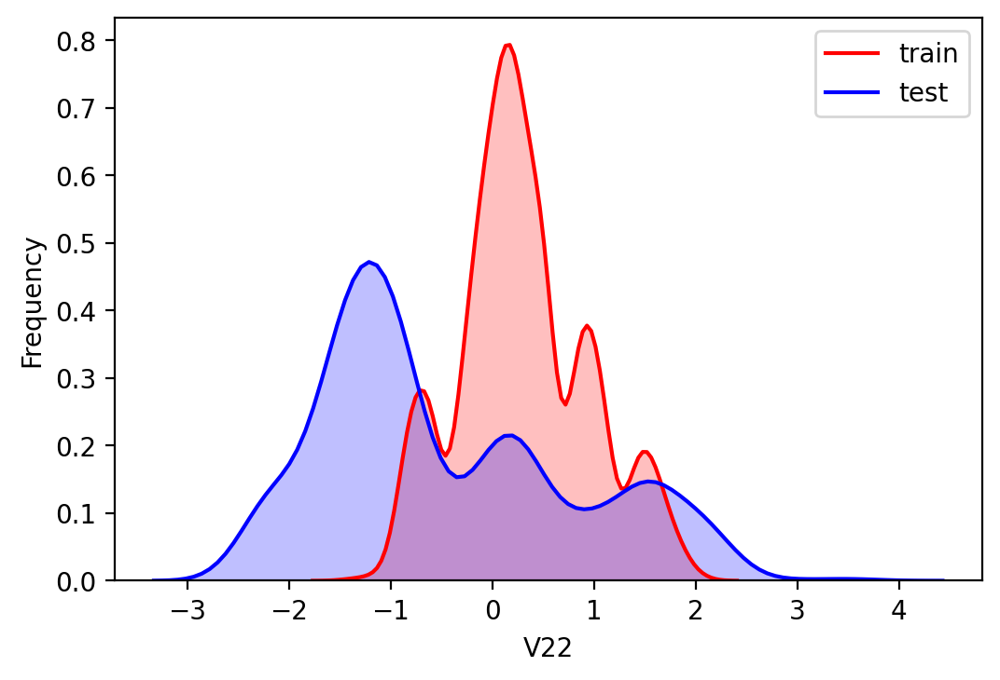

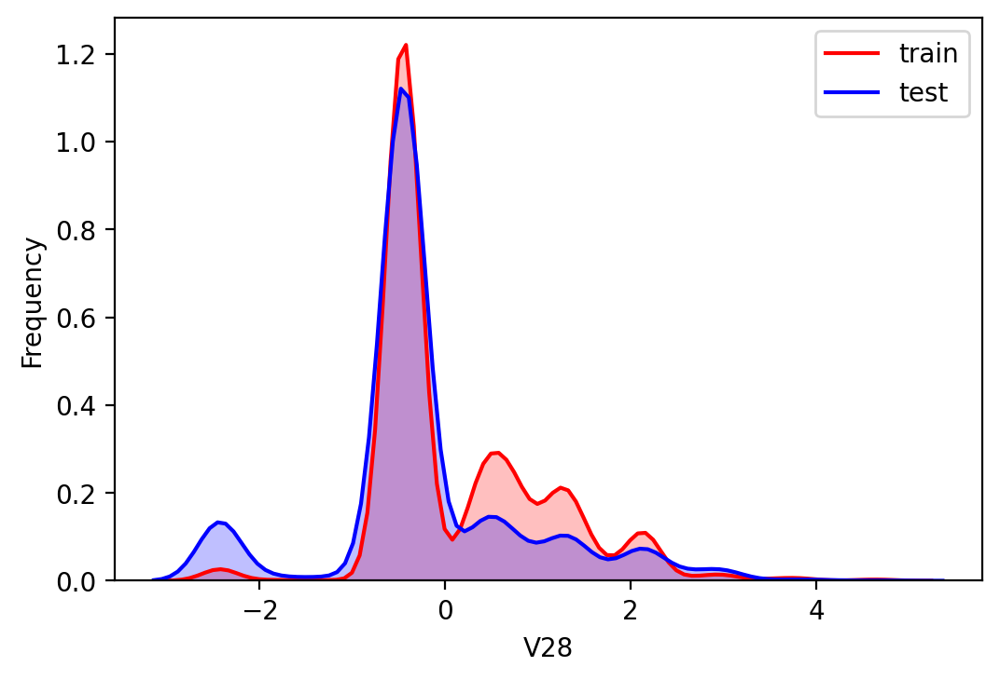

In [7]:
# 训练集和测试集分布不均
# 删除特征"V5","V9","V11","V17","V22","V28"
for column in ["V5","V9","V11","V17","V22","V28"]:
    g = sns.kdeplot(data_all[column][(data_all["origin"] == "train")], color="Red", shade = True)
    g = sns.kdeplot(data_all[column][(data_all["origin"] == "test")], ax =g, color="Blue", shade= True)
    g.set_xlabel(column)
    g.set_ylabel("Frequency")
    g = g.legend(["train","test"])
    plt.show()

data_all.drop(["V5","V9","V11","V17","V22","V28"],axis=1,inplace=True)

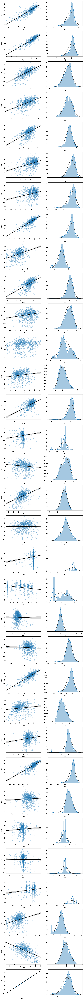

In [8]:
# figure parameters
data_train1=data_all[data_all["origin"]=="train"].drop("origin",axis=1)

fcols = 2
frows = len(data_train.columns)
plt.figure(figsize=(5*fcols,4*frows))

i=0
for col in data_train1.columns:
    i+=1
    ax=plt.subplot(frows,fcols,i)
    sns.regplot(x=col, y='target', data=data_train, ax=ax, 
                scatter_kws={'marker':'.','s':3,'alpha':0.3},
                line_kws={'color':'k'});
    plt.xlabel(col)
    plt.ylabel('target')
    
    i+=1
    ax=plt.subplot(frows,fcols,i)
    sns.distplot(data_train[col].dropna() , fit=stats.norm)
    plt.xlabel(col)

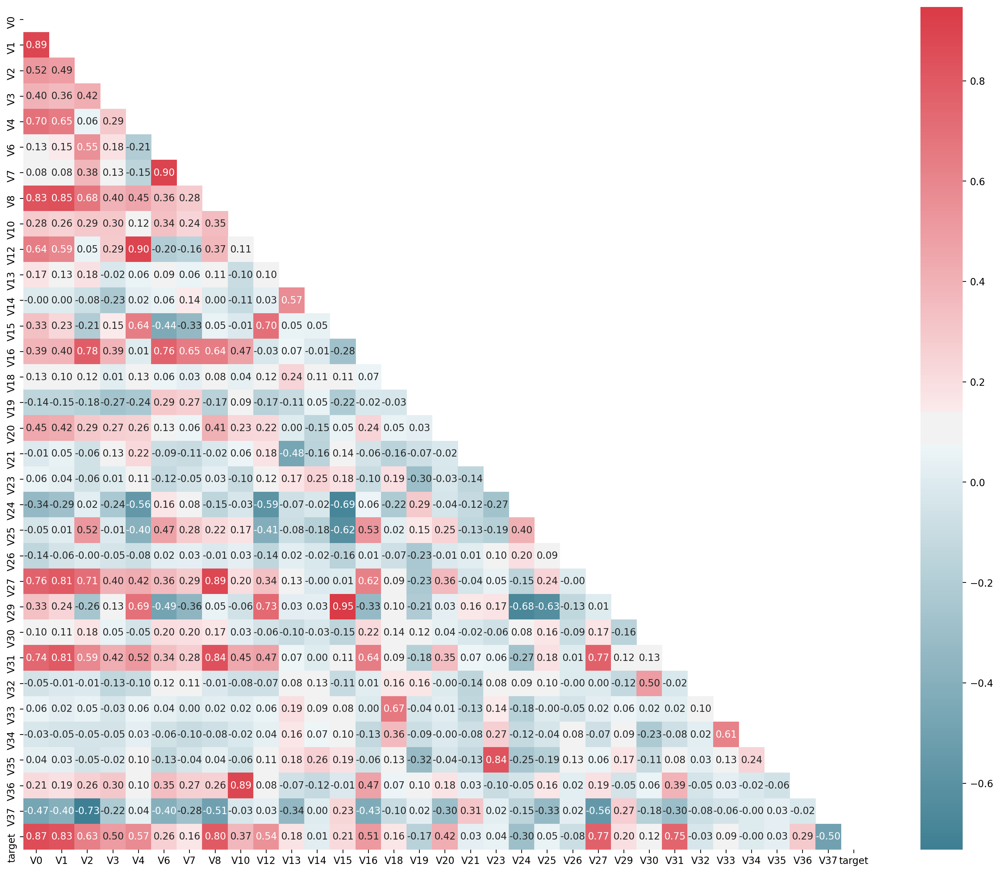

In [9]:
# 找出相关程度
plt.figure(figsize=(20, 16))
colnm = data_train1.columns.tolist()

# 相关系数矩阵，给出任意两个变量之间的相关系数
mcorr = data_train1[colnm].corr(method="spearman")  
# 构造与mcorr同维数矩阵 为bool型
mask = np.zeros_like(mcorr, dtype=np.bool)
# 对角线右侧为True
mask[np.triu_indices_from(mask)] = True
# 返回matplotlib colormap对象
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# 热力图，查看特征之间的相似度
g = sns.heatmap(mcorr, mask=mask, cmap=cmap, square=True, annot=True, fmt='0.2f')
plt.show()

In [70]:
mask

array([[ True,  True,  True, ...,  True,  True,  True],
       [False,  True,  True, ...,  True,  True,  True],
       [False, False,  True, ...,  True,  True,  True],
       ...,
       [False, False, False, ...,  True,  True,  True],
       [False, False, False, ..., False,  True,  True],
       [False, False, False, ..., False, False,  True]])

In [10]:
# # Threshold for removing correlated variables
# threshold = 0.1

# # Absolute value correlation matrix
# corr_matrix = data_train1.corr().abs()
# drop_col=corr_matrix[corr_matrix["target"]<threshold].index
# data_all.drop(drop_col,axis=1,inplace=True)

In [11]:
# 标准化数据
cols_numeric=list(data_all.columns)
cols_numeric.remove("origin")

def scale_minmax(col):
    return (col-col.min())/(col.max()-col.min())

scale_cols = [col for col in cols_numeric if col!='target']
data_all[scale_cols] = data_all[scale_cols].apply(scale_minmax,axis=0)
data_all[scale_cols].describe()

,V0,V1,V2,V3,V4,V6,V7,V8,V10,V12,...,V27,V29,V30,V31,V32,V33,V34,V35,V36,V37
count,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,...,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000,4813.000000
mean,0.694172,0.721357,0.602300,0.603139,0.523743,0.748823,0.745740,0.715607,0.348518,0.578507,...,0.881401,0.388683,0.589459,0.792709,0.628824,0.458493,0.483790,0.762873,0.332385,0.545795
std,0.144198,0.131443,0.140628,0.152462,0.106430,0.132560,0.132577,0.118105,0.134882,0.105088,...,0.128221,0.133475,0.130786,0.102976,0.155003,0.099095,0.101020,0.102037,0.127456,0.150356
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.626676,0.679416,0.514414,0.503888,0.478182,0.683324,0.696938,0.664934,0.284327,0.532892,...,0.888575,0.292445,0.550092,0.761816,0.562461,0.409037,0.454490,0.727273,0.270584,0.445647
50%,0.729488,0.752497,0.617072,0.614270,0.535866,0.774125,0.771974,0.742884,0.366469,0.591635,...,0.916015,0.375734,0.594428,0.815055,0.643056,0.454518,0.499949,0.800020,0.347056,0.539317
75%,0.790195,0.799553,0.700464,0.710474,0.585036,0.842259,0.836405,0.790835,0.432965,0.641971,...,0.932555,0.471837,0.650798,0.852229,0.719777,0.500000,0.511365,0.800020,0.414861,0.643061
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [13]:
# Check effect of Box-Cox transforms on distributions of continuous variables

fcols = 6
frows = len(cols_numeric)-1
plt.figure(figsize=(4*fcols,4*frows))
i=0

for var in cols_numeric:
    if var!='target':
        dat = data_all[[var, 'target']].dropna()
        
        i+=1
        plt.subplot(frows,fcols,i)
        sns.distplot(dat[var] , fit=stats.norm);
        plt.title(var+' Original')
        plt.xlabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        _=stats.probplot(dat[var], plot=plt)
        plt.title('skew='+'{:.4f}'.format(stats.skew(dat[var])))
        plt.xlabel('')
        plt.ylabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        plt.plot(dat[var], dat['target'],'.',alpha=0.5)
        plt.title('corr='+'{:.2f}'.format(np.corrcoef(dat[var], dat['target'])[0][1]))
 
        i+=1
        plt.subplot(frows,fcols,i)
        
        # 做回归分析时，通常假设回归方程的残差具有有齐性，即等方差。
        # 如果残差不满足齐性，即出现异方差（残差发散），此时就可以通过做Box-Cox变换实现回归方程残差齐性。
        trans_var, lambda_var = stats.boxcox(dat[var].dropna()+1)
        trans_var = scale_minmax(trans_var)      
        sns.distplot(trans_var , fit=stats.norm);
        plt.title(var + ' Tramsformed')
        plt.xlabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        _=stats.probplot(trans_var, plot=plt)
        plt.title('skew='+'{:.4f}'.format(stats.skew(trans_var)))
        plt.xlabel('')
        plt.ylabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        plt.plot(trans_var, dat['target'],'.',alpha=0.5)
        plt.title('corr='+'{:.2f}'.format(np.corrcoef(trans_var,dat['target'])[0][1]))

In [14]:
cols_transform=data_all.columns[0:-2]
for col in cols_transform:   
    # transform column
    data_all.loc[:,col], _ = stats.boxcox(data_all.loc[:,col]+1)

count    2888.000000
mean        0.126353
std         0.983966
min        -3.044000
25%        -0.350250
50%         0.313000
75%         0.793250
max         2.538000
Name: target, dtype: float64


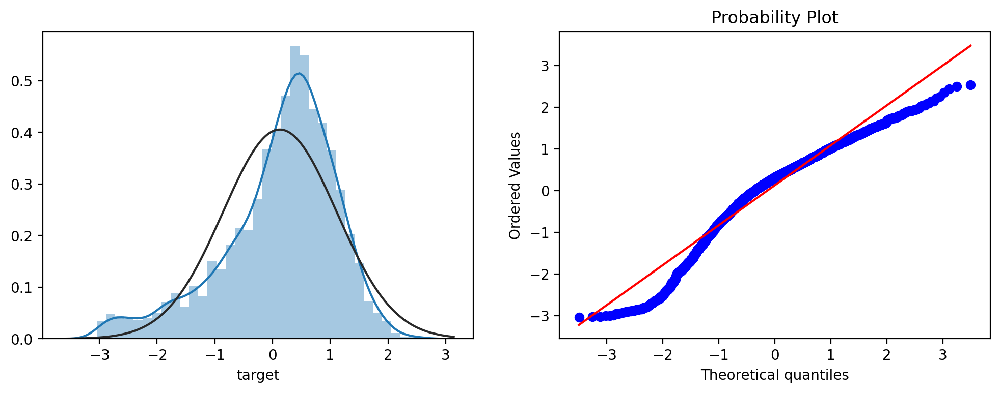

In [15]:
print(data_all.target.describe())

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
sns.distplot(data_all.target.dropna() , fit=stats.norm);
plt.subplot(1,2,2)
_=stats.probplot(data_all.target.dropna(), plot=plt)

count    2888.000000
mean        1.129957
std         0.394110
min         0.291057
25%         0.867609
50%         1.135315
75%         1.379382
max         2.798463
Name: target, dtype: float64


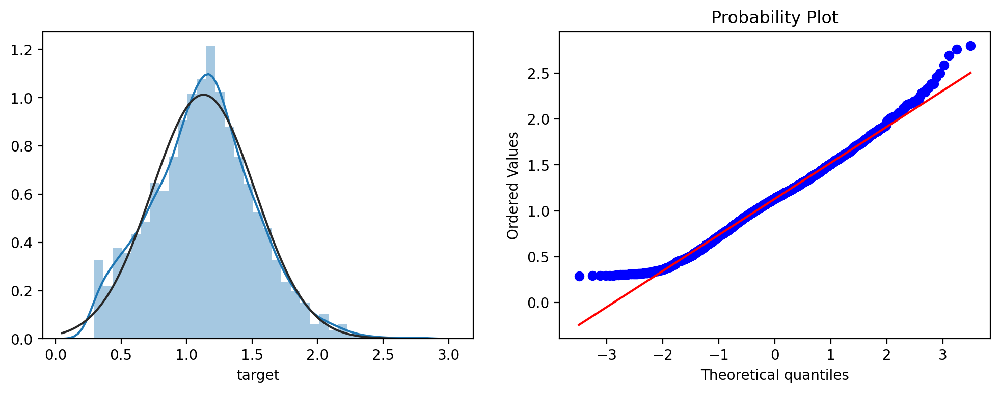

In [16]:
# Log Transform SalePrice to improve normality
sp = data_train.target
data_train.target1 =np.power(1.5,sp)
print(data_train.target1.describe())

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
sns.distplot(data_train.target1.dropna(), fit=stats.norm);
plt.subplot(1,2,2)
_=stats.probplot(data_train.target1.dropna(), plot=plt)

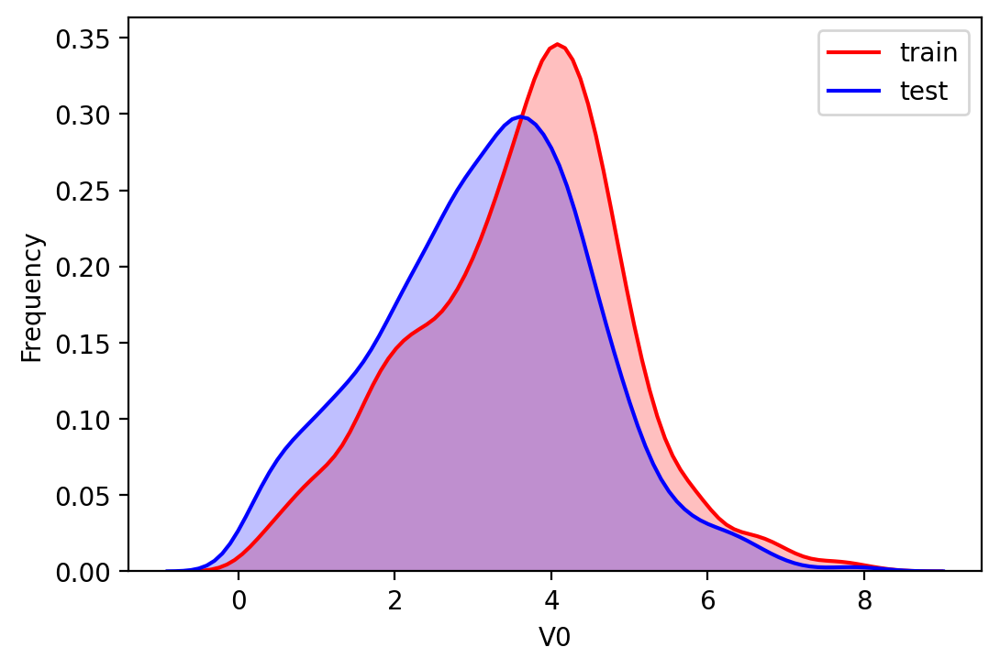

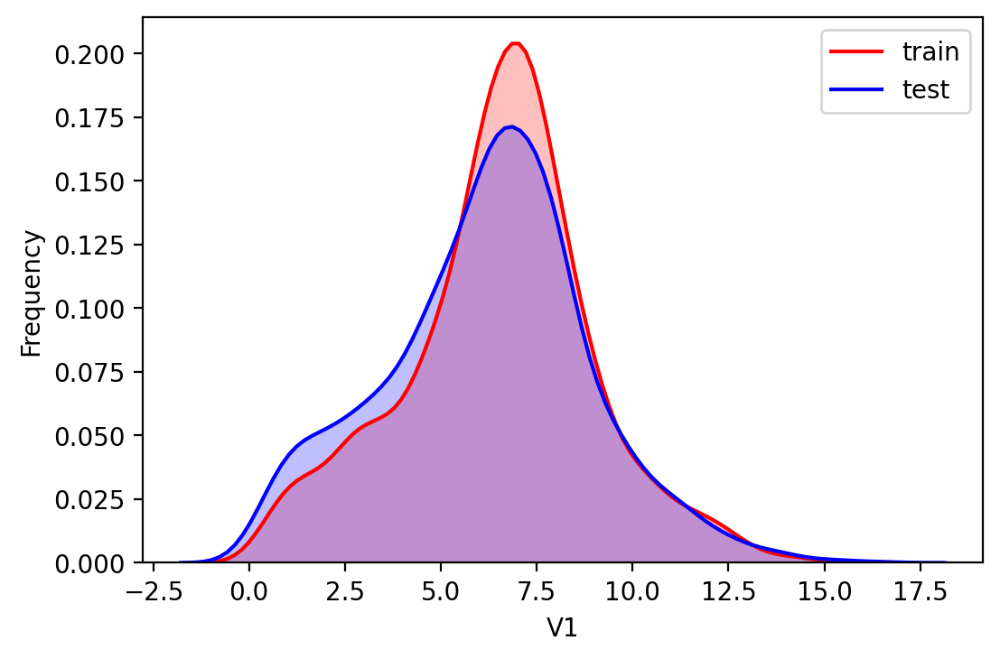

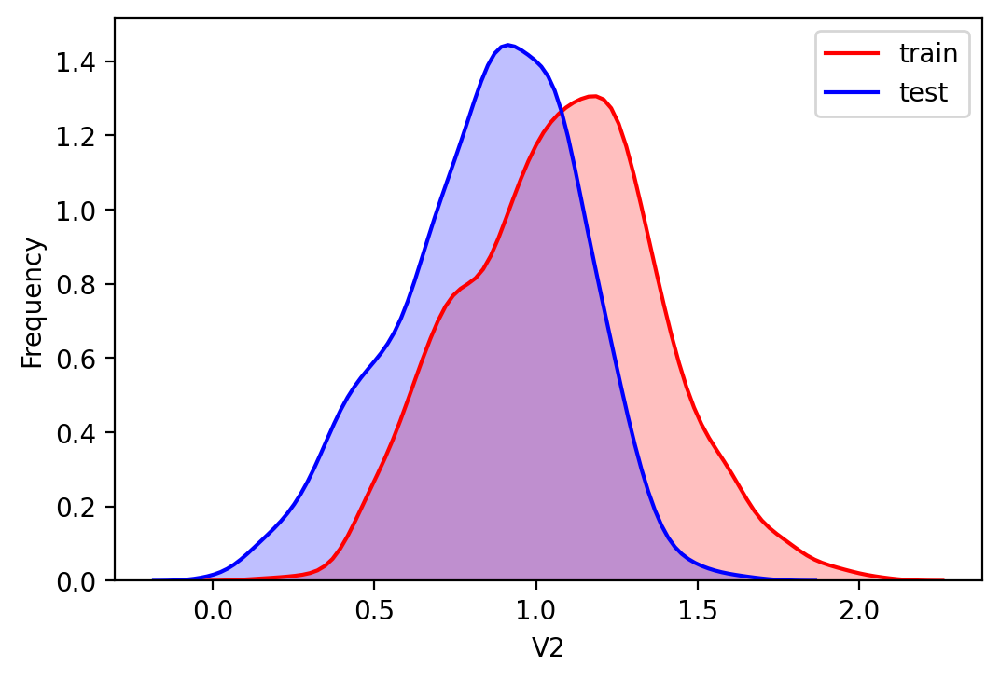

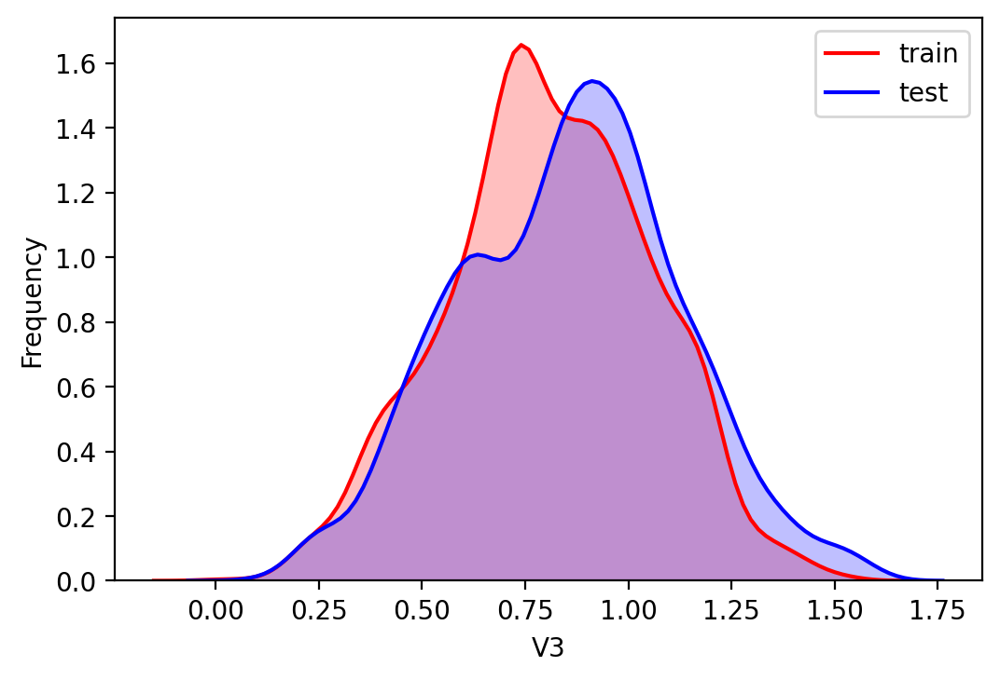

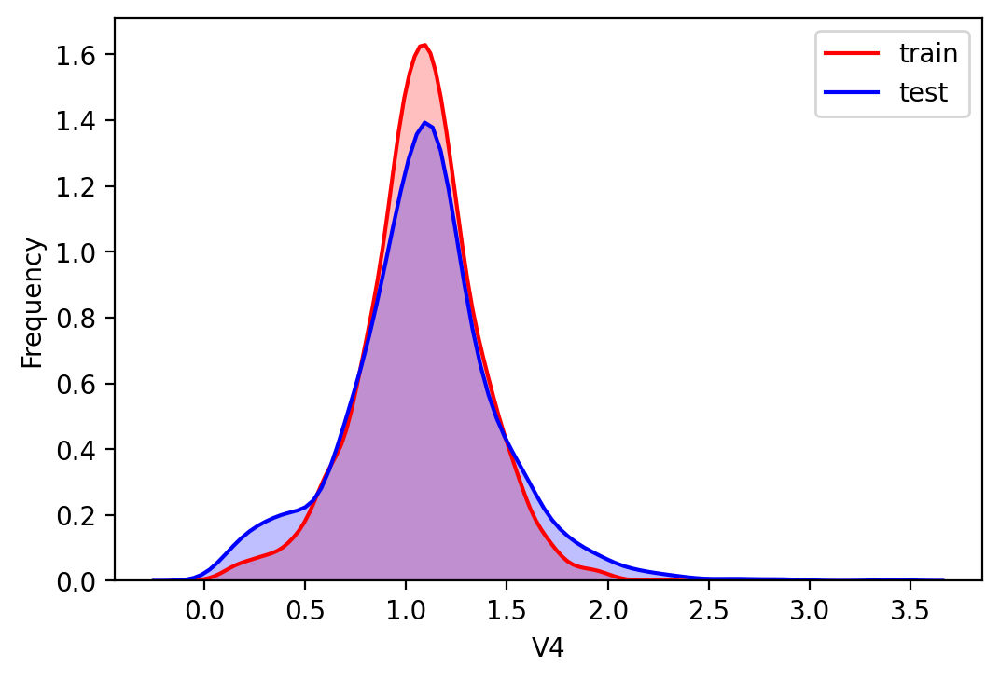

...

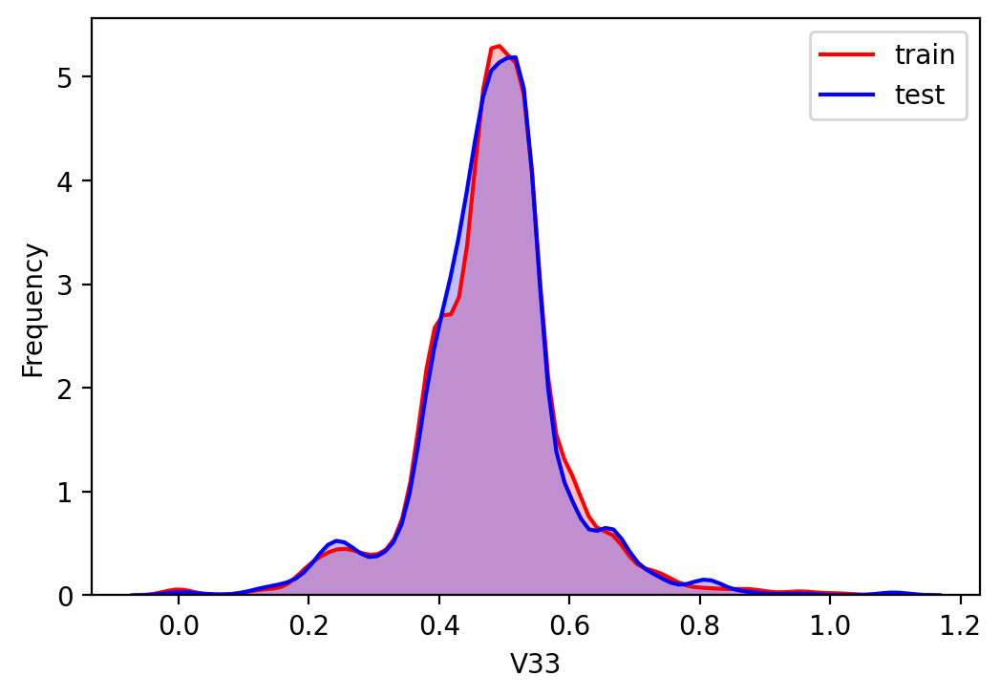

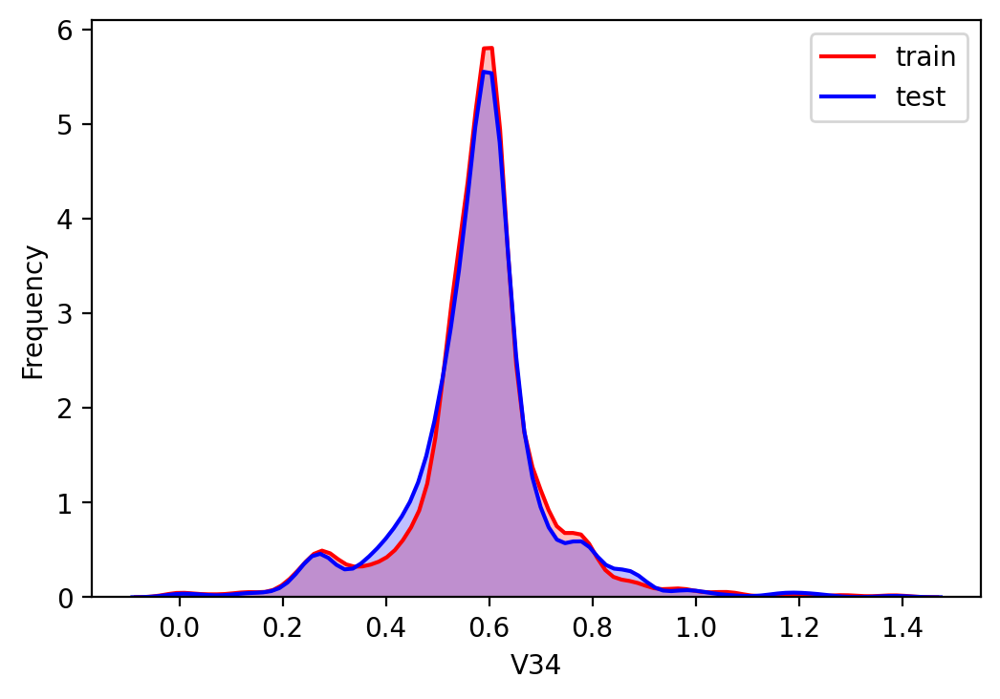

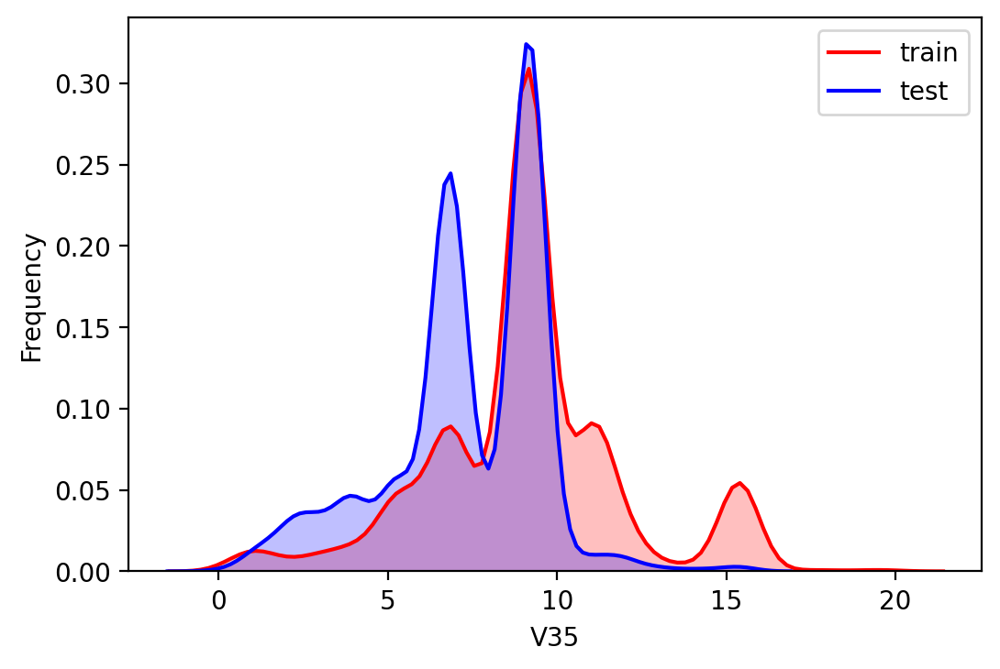

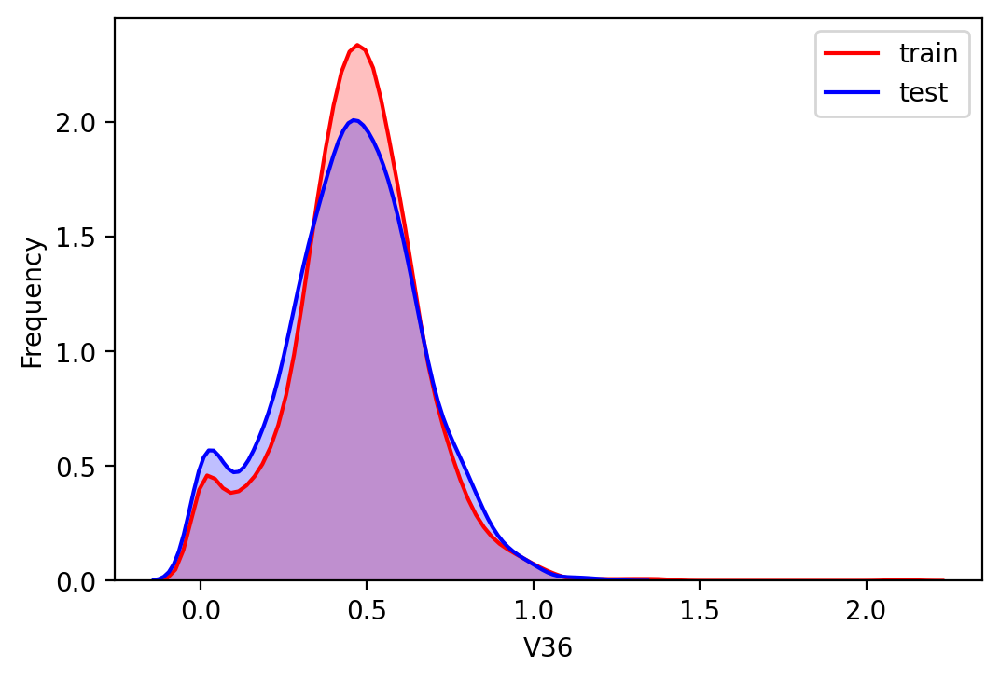

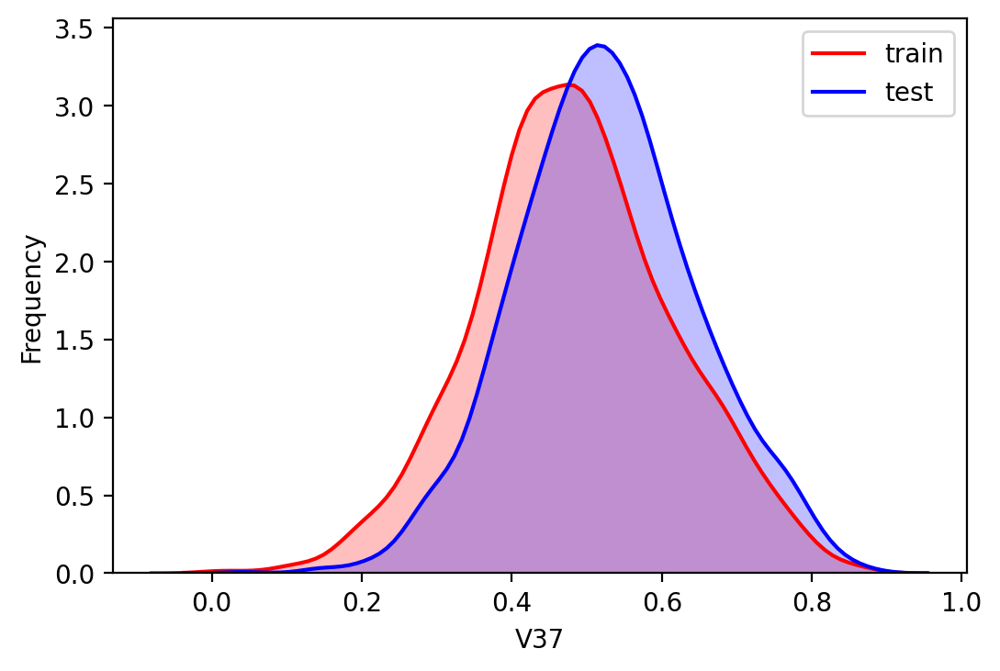

In [17]:
for column in data_all.columns[0:-2]:
    g = sns.kdeplot(data_all[column][(data_all["origin"] == "train")], color="Red", shade = True)
    g = sns.kdeplot(data_all[column][(data_all["origin"] == "test")], ax =g, color="Blue", shade= True)
    g.set_xlabel(column)
    g.set_ylabel("Frequency")
    g = g.legend(["train","test"])
    plt.show()

In [18]:
def get_training_data():
    from sklearn.model_selection import train_test_split
    df_train = data_all[data_all["origin"]=="train"]
    df_train["label"]=data_train.target1
    
    y = df_train.target
    X = df_train.drop(["origin","target","label"],axis=1)
    
    X_train,X_valid,y_train,y_valid=train_test_split(X,y,test_size=0.3,random_state=100)
    
    return X_train,X_valid,y_train,y_valid

def get_test_data():
    df_test = data_all[data_all["origin"]=="test"].reset_index(drop=True)
    
    return df_test.drop(["origin","target"],axis=1)

In [19]:
from sklearn.metrics import make_scorer

def rmse(y_true, y_pred):
    diff = y_pred - y_true
    sum_sq = sum(diff**2)    
    n = len(y_pred)
    return np.sqrt(sum_sq/n)

def mse(y_ture,y_pred):
    return mean_squared_error(y_ture,y_pred)

# sklearn模型拟合中使用的计分器
rmse_scorer = make_scorer(rmse, greater_is_better=False)
mse_scorer = make_scorer(mse, greater_is_better=False)

In [20]:
# 根据模型的预测来检测异常值的函数
def find_outliers(model, X, y, sigma=3):

    try:
        y_pred = pd.Series(model.predict(X), index=y.index)
    
    # 如果预测失败，则先拟合模型
    except:
        model.fit(X,y)
        y_pred = pd.Series(model.predict(X), index=y.index)
        
    # 计算模型预测与真实y值之间的残差
    resid = y - y_pred
    mean_resid = resid.mean()
    std_resid = resid.std()

    # 计算z统计量，将离群值定义为|z|> sigma
    z = (resid - mean_resid)/std_resid    
    outliers = z[abs(z)>sigma].index
    
    # 打印并绘制结果
    print('R2=',model.score(X,y))
    print('rmse=',rmse(y, y_pred))
    print("mse=",mean_squared_error(y,y_pred))
    print('---------------------------------------')

    print('mean of residuals:',mean_resid)
    print('std of residuals:',std_resid)
    print('---------------------------------------')

    print(len(outliers),'outliers:')
    print(outliers.tolist())

    plt.figure(figsize=(15,5))
    ax_131 = plt.subplot(1,3,1)
    plt.plot(y,y_pred,'.')
    plt.plot(y.loc[outliers],y_pred.loc[outliers],'ro')
    plt.legend(['Accepted','Outlier'])
    plt.xlabel('y')
    plt.ylabel('y_pred');

    ax_132=plt.subplot(1,3,2)
    plt.plot(y,y-y_pred,'.')
    plt.plot(y.loc[outliers],y.loc[outliers]-y_pred.loc[outliers],'ro')
    plt.legend(['Accepted','Outlier'])
    plt.xlabel('y')
    plt.ylabel('y - y_pred');

    ax_133=plt.subplot(1,3,3)
    z.plot.hist(bins=50,ax=ax_133)
    z.loc[outliers].plot.hist(color='r',bins=50,ax=ax_133)
    plt.legend(['Accepted','Outlier'])
    plt.xlabel('z')
    
    plt.savefig('outliers.png')
    
    return outliers

R2= 0.8794138470953502
rmse= 0.34510338815050146
mse= 0.11909634851295575
---------------------------------------
mean of residuals: -3.856390713937951e-16
std of residuals: 0.34518879921186396
---------------------------------------
23 outliers:
[2655, 2159, 1164, 2863, 1145, 2697, 2528, 2645, 691, 1085, 1874, 2647, 776, 2625, 884, 2696, 2668, 1310, 1901, 2769, 2002, 2669, 1040]


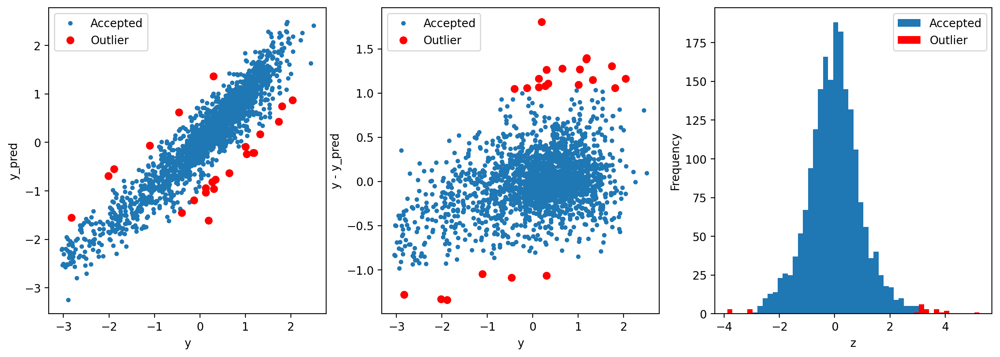

In [21]:
from sklearn.linear_model import Ridge

X_train, X_valid,y_train,y_valid = get_training_data()
test=get_test_data()

# 使用Ridge模型查找并删除异常值
# 该模型解决了一个回归模型，其中损失函数是线性最小二乘函数，而正则化由l2-范数给出。也称为Ridge回归或Tikhonov正则化。
outliers = find_outliers(Ridge(), X_train, y_train)

X_outliers=X_train.loc[outliers]
y_outliers=y_train.loc[outliers]

X_t=X_train.drop(outliers)
y_t=y_train.drop(outliers)

In [22]:
def get_trainning_data_omitoutliers():
    y1=y_t.copy()
    X1=X_t.copy()
    return X1,y1

In [23]:
from sklearn.preprocessing import StandardScaler

def train_model(model, 
                param_grid=[], 
                X=[], 
                y=[], 
                splits=5, 
                repeats=5):

    # 获取未经修改的训练数据，除非已指定要使用的数据
    if len(y)==0:
        X,y = get_trainning_data_omitoutliers()
    
    # 创建交叉验证方法
    rkfold = RepeatedKFold(n_splits=splits, n_repeats=repeats)
    
    # 如果指定了param_grid，则执行网格搜索
    if len(param_grid)>0:
        
        # 设置网格搜索参数
        gsearch = GridSearchCV(model, 
                               param_grid, 
                               cv=rkfold,
                               scoring="neg_mean_squared_error",
                               verbose=1, 
                               return_train_score=True)

        # 网格搜索
        gsearch.fit(X,y)

        # 从网格中提取最佳模型
        model = gsearch.best_estimator_        
        best_idx = gsearch.best_index_

        # 获得最佳模型的交叉验证分数
        grid_results = pd.DataFrame(gsearch.cv_results_)       
        cv_mean = abs(grid_results.loc[best_idx,'mean_test_score'])
        cv_std = grid_results.loc[best_idx,'std_test_score']

    # 没有网格搜索，只给定模型的交叉验证分数
    else:
        grid_results = []
        cv_results = cross_val_score(model, X, y, scoring="neg_mean_squared_error", cv=rkfold)
        cv_mean = abs(np.mean(cv_results))
        cv_std = np.std(cv_results)
    
    # 将交叉验证分数的均值和标准差写入pandas
    cv_score = pd.Series({'mean':cv_mean,'std':cv_std})

    # 使用拟合模型预测y
    y_pred = model.predict(X)
    
    # 打印有关模型性能的统计信息
    print('----------------------')
    print(model)
    print('----------------------')
    
    # .score()作用：返回该次预测的系数R2。其中，R2 =（1-u/v）。
    # u=((y_true - y_pred) ** 2).sum()；v=((y_true - y_true.mean()) ** 2).sum()
    print('score=',model.score(X,y))
    
    print('rmse=', rmse(y, y_pred))
    print('mse=', mse(y, y_pred))
    print('cross_val: mean=',cv_mean,', std=',cv_std)
    
    # 残差图
    y_pred = pd.Series(y_pred,index=y.index)
    resid = y - y_pred
    mean_resid = resid.mean()
    std_resid = resid.std()
    z = (resid - mean_resid)/std_resid    
    n_outliers = sum(abs(z)>3)
    
    plt.figure(figsize=(15,5))
    ax_131 = plt.subplot(1,3,1)
    plt.plot(y,y_pred,'.')
    plt.xlabel('y')
    plt.ylabel('y_pred');
    plt.title('corr = {:.3f}'.format(np.corrcoef(y,y_pred)[0][1]))
    
    ax_132=plt.subplot(1,3,2)
    plt.plot(y,y-y_pred,'.')
    plt.xlabel('y')
    plt.ylabel('y - y_pred');
    plt.title('std resid = {:.3f}'.format(std_resid))
    
    ax_133=plt.subplot(1,3,3)
    z.plot.hist(bins=50,ax=ax_133)
    plt.xlabel('z')
    plt.title('{:.0f} samples with z>3'.format(n_outliers))

    return model, cv_score, grid_results

In [24]:
# 存储最佳模型和分数的位置
opt_models = dict()
score_models = pd.DataFrame(columns=['mean','std'])

# no. k-fold splits
splits=5
# no. k-fold iterations
repeats=5

Fitting 25 folds for each of 23 candidates, totalling 575 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 575 out of 575 | elapsed:    2.8s finished


----------------------
Ridge(alpha=0.25)
----------------------
score= 0.8963563382458094
rmse= 0.3189964919993529
mse= 0.1017587619078934
cross_val: mean= 0.10650953276938642 , std= 0.008137990268332701


Text(0, 0.5, 'score')

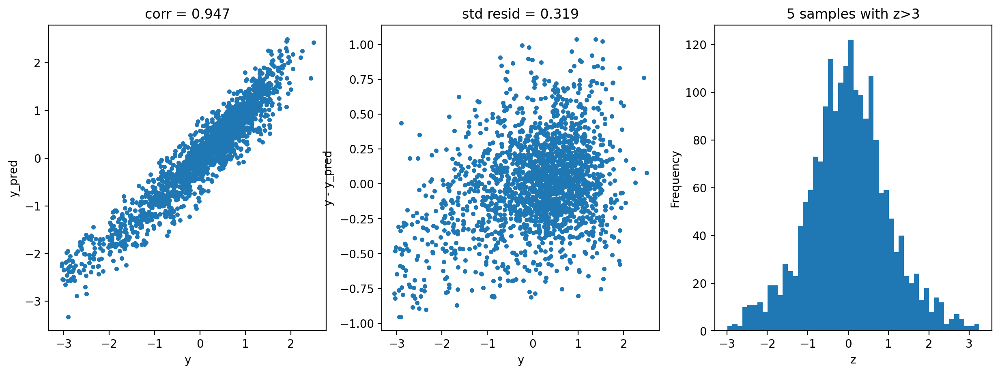

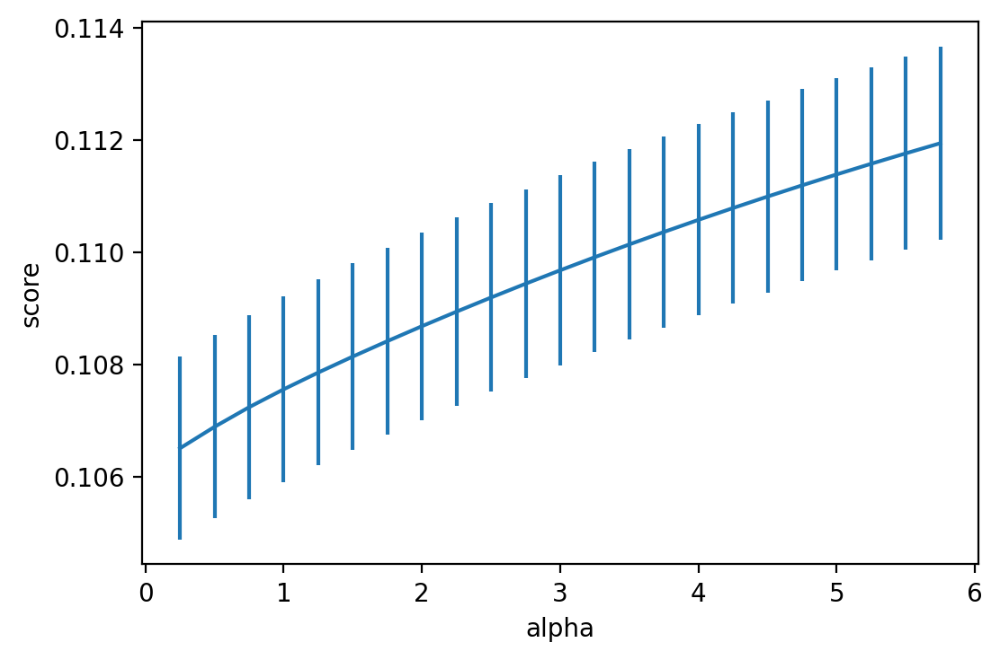

In [25]:
model = 'Ridge'

opt_models[model] = Ridge()
alph_range = np.arange(0.25,6,0.25)
param_grid = {'alpha': alph_range}

opt_models[model],cv_score,grid_results = train_model(opt_models[model], 
                                                      param_grid=param_grid, 
                                                      splits=splits, repeats=repeats)

cv_score.name = model
score_models = score_models.append(cv_score)

plt.figure()
plt.errorbar(alph_range, 
             abs(grid_results['mean_test_score']),
             abs(grid_results['std_test_score'])/np.sqrt(splits*repeats))

plt.xlabel('alpha')
plt.ylabel('score')

$(1 / (2 * n\_samples)) * ||y - Xw||^2_2 + alpha * ||w||_1$

Fitting 25 folds for each of 23 candidates, totalling 575 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


----------------------
Lasso(alpha=0.0001)
----------------------
score= 0.8965376024713236
rmse= 0.31871742063608494
mse= 0.10158079421691905
cross_val: mean= 0.10626026269524745 , std= 0.006580528126280954


[Parallel(n_jobs=1)]: Done 575 out of 575 | elapsed:    6.1s finished


Text(0, 0.5, 'score')

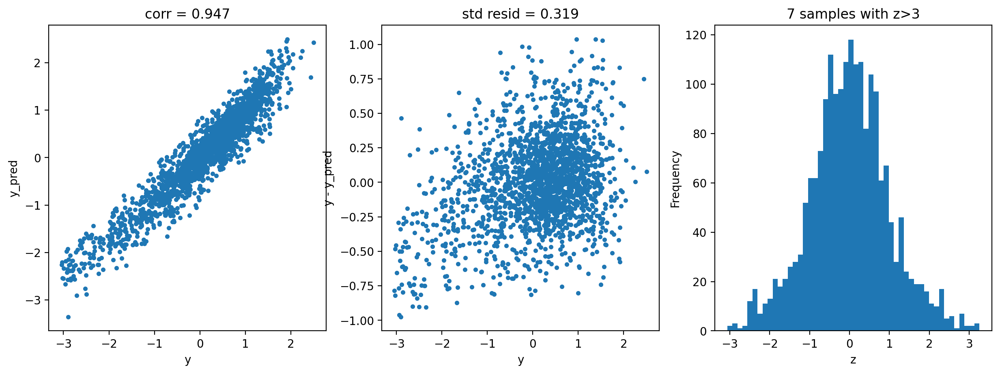

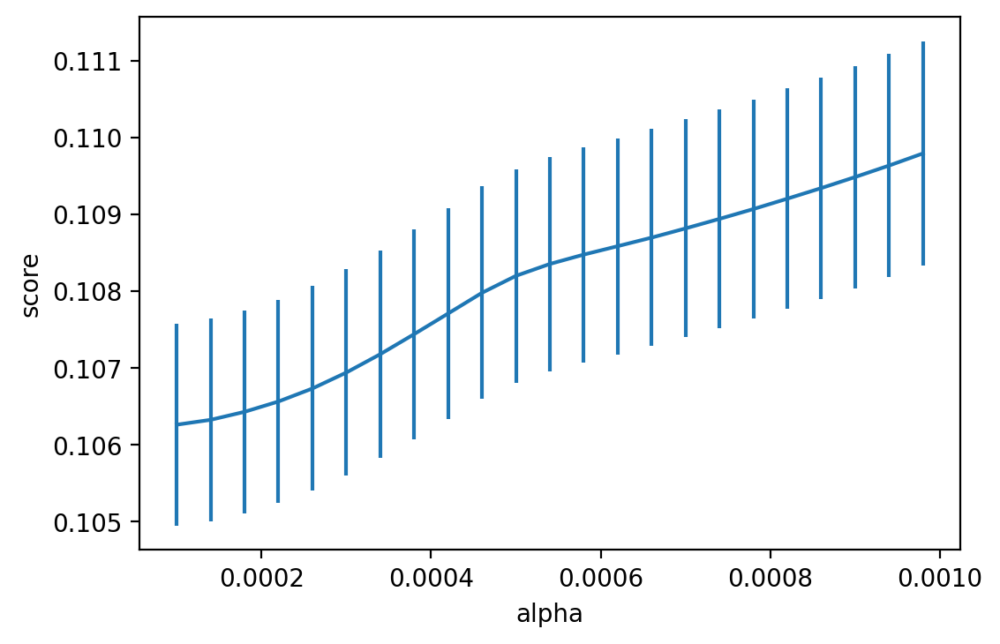

In [26]:
'''
Lasso是Least Absolute Shrinkage and Selection Operator的简称，
是一种采用了L1正则化的线性回归方法，
采用了L1正则会使得部分学习到的特征权值为0，从而达到稀疏化和特征选择的目的。

Lasso模型与Elastic Net相同的目标函数，且l1_ratio=1.0，没有L2损失。
'''

model = 'Lasso'

opt_models[model] = Lasso()
alph_range = np.arange(1e-4,1e-3,4e-5)
param_grid = {'alpha': alph_range}

opt_models[model], cv_score, grid_results = train_model(opt_models[model], 
                                                        param_grid=param_grid, 
                                                        splits=splits, repeats=repeats)

cv_score.name = model
score_models = score_models.append(cv_score)

plt.figure()
plt.errorbar(alph_range, 
             abs(grid_results['mean_test_score']),
             abs(grid_results['std_test_score'])/np.sqrt(splits*repeats))

plt.xlabel('alpha')
plt.ylabel('score')

Fitting 5 folds for each of 81 candidates, totalling 405 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 405 out of 405 | elapsed:    4.5s finished


----------------------
ElasticNet(alpha=0.0001, l1_ratio=0.9, max_iter=100000)
----------------------
score= 0.8965268228807055
rmse= 0.31873402354649244
mse= 0.10159137776613575
cross_val: mean= 0.10609854352343136 , std= 0.00557622169116057


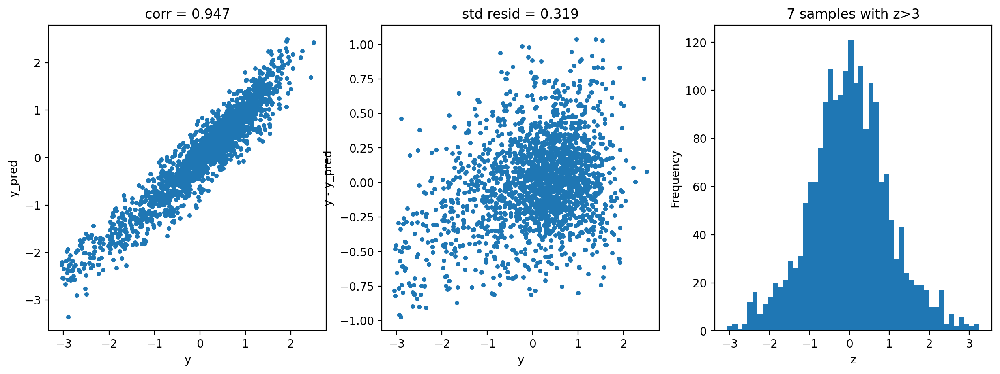

In [27]:
'''
ElasticNet是一种使用L1和L2先验作为正则化矩阵的线性回归模型。
这种组合用于只有很少的权重非零的稀疏模型，比如Lasso, 但是又能保持Ridge的正则化属性。
可以使用 l1_ratio 参数来调节L1和L2的凸组合(一类特殊的线性组合)。

当多个特征和另一个特征相关的时候弹性网络非常有用。Lasso 倾向于随机选择其中一个，而弹性网络更倾向于选择两个。
在实践中，Lasso 和 Ridge 之间权衡的一个优势是它允许在循环过程（Under rotate）中继承 Ridge 的稳定性。

'''

model ='ElasticNet'
opt_models[model] = ElasticNet()

param_grid = {'alpha': np.arange(1e-4,1e-3,1e-4),
              'l1_ratio': np.arange(0.1,1.0,0.1),
              'max_iter':[100000]}

opt_models[model], cv_score, grid_results = train_model(opt_models[model], 
                                                        param_grid=param_grid, 
                                                        splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

Fitting 25 folds for each of 9 candidates, totalling 225 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 225 out of 225 | elapsed:   29.1s finished


----------------------
LinearSVR(C=0.1)
----------------------
score= 0.37789642364674536
rmse= 0.7815304110189581
mse= 0.6107897833474629
cross_val: mean= 1.541159287398929 , std= 3.385236786021301


Text(0, 0.5, 'score')

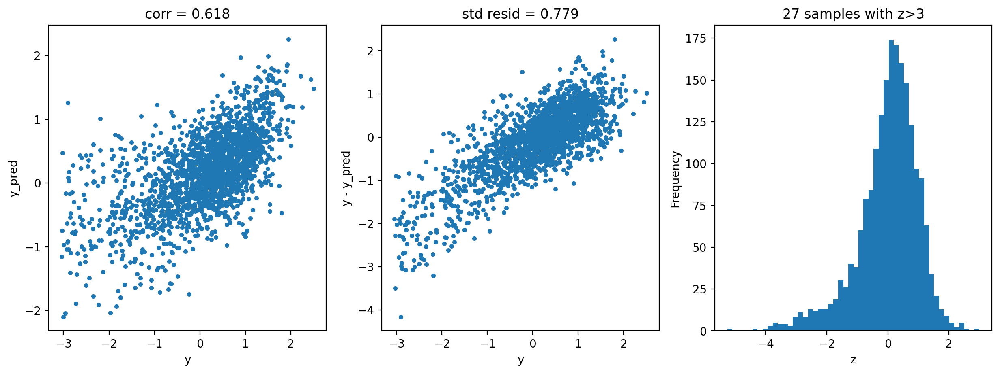

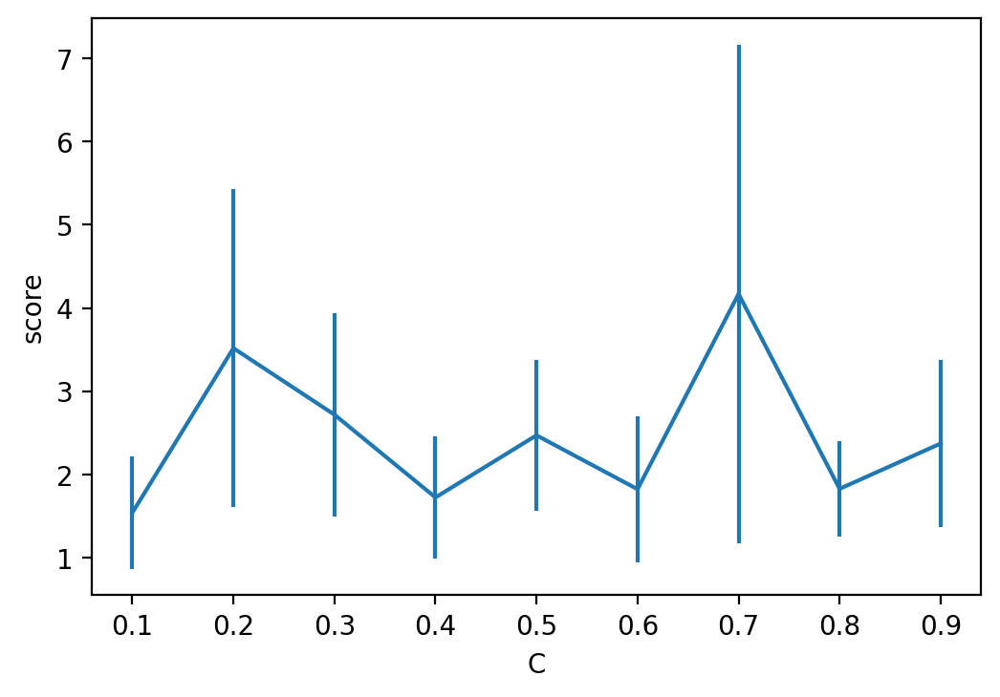

In [28]:
model='LinearSVR'
opt_models[model] = LinearSVR()

crange = np.arange(0.1,1.0,0.1)
param_grid = {'C':crange,
              'max_iter':[1000]}

opt_models[model], cv_score, grid_results = train_model(opt_models[model], 
                                                        param_grid=param_grid, 
                                                        splits=splits, repeats=repeats)

cv_score.name = model
score_models = score_models.append(cv_score)

plt.figure()
plt.errorbar(crange, 
             abs(grid_results['mean_test_score']),
             abs(grid_results['std_test_score'])/np.sqrt(splits*repeats))

plt.xlabel('C')
plt.ylabel('score')

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


----------------------
KNeighborsRegressor(n_neighbors=10)
----------------------
score= 0.7188007679386812
rmse= 0.5254381453364181
mse= 0.27608524457457456
cross_val: mean= 0.341109544157995 , std= 0.027473832995287144


[Parallel(n_jobs=1)]: Done  40 out of  40 | elapsed:    0.8s finished


Text(0, 0.5, 'score')

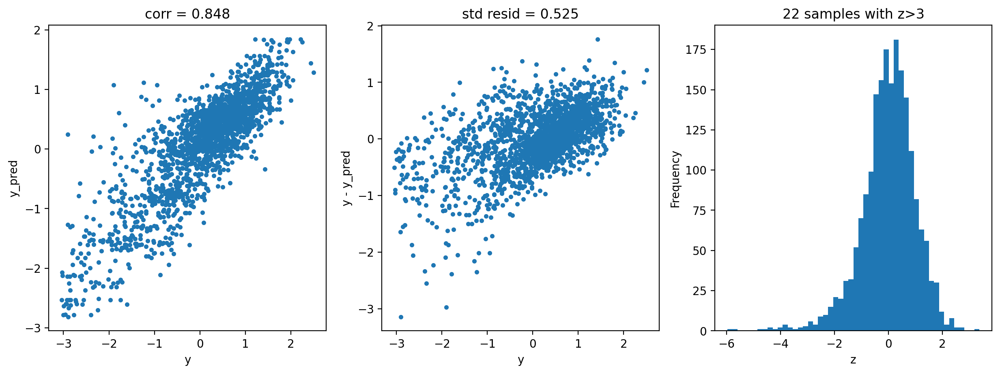

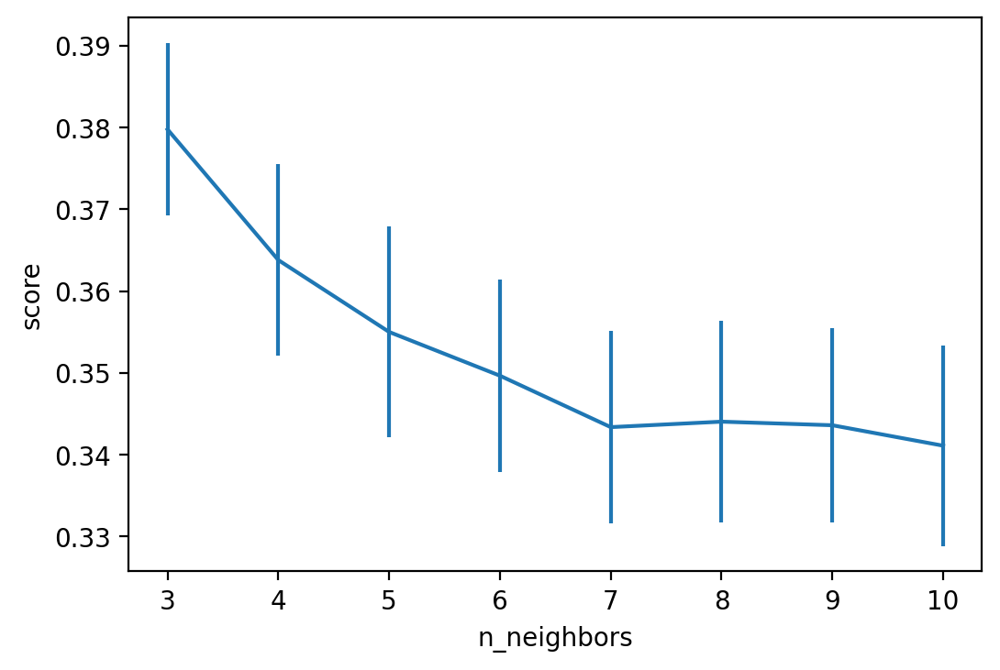

In [29]:
model = 'KNeighbors'
opt_models[model] = KNeighborsRegressor()

param_grid = {'n_neighbors':np.arange(3,11,1)}

opt_models[model], cv_score, grid_results = train_model(opt_models[model], 
                                                        param_grid=param_grid, 
                                                        splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

plt.figure()
plt.errorbar(np.arange(3,11,1), 
             abs(grid_results['mean_test_score']),
             abs(grid_results['std_test_score'])/np.sqrt(splits*1))

plt.xlabel('n_neighbors')
plt.ylabel('score')

Fitting 5 folds for each of 27 candidates, totalling 135 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 135 out of 135 | elapsed:  3.3min finished


----------------------
GradientBoostingRegressor(min_samples_split=7, n_estimators=150)
----------------------
score= 0.9540614083174764
rmse= 0.21237499006003938
mse= 0.04510313640300183
cross_val: mean= 0.09840281880937587 , std= 0.00828111821672154


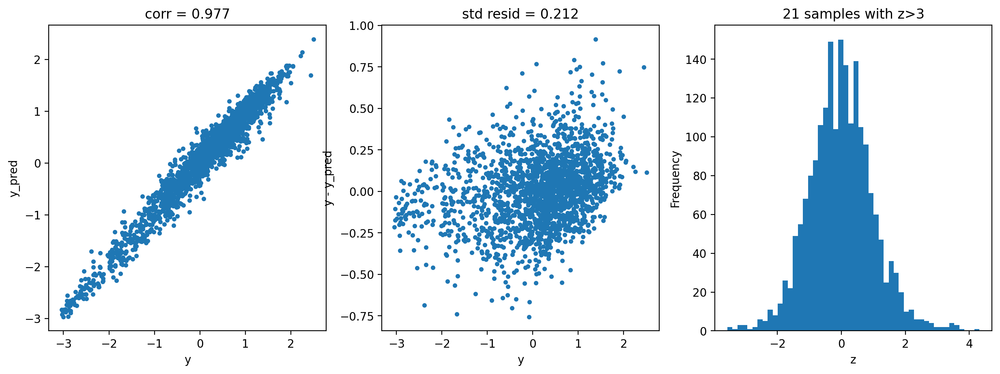

In [30]:
model = 'GradientBoosting'
opt_models[model] = GradientBoostingRegressor()

param_grid = {'n_estimators':[150,250,350],
              'max_depth':[1,2,3],
              'min_samples_split':[5,6,7]}

opt_models[model], cv_score, grid_results = train_model(opt_models[model], 
                                                        param_grid=param_grid, 
                                                        splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

Fitting 5 folds for each of 15 candidates, totalling 75 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed:    9.6s finished


----------------------
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=2,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=200, n_jobs=0, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)
----------------------
score= 0.961471457807996
rmse= 0.19449382679567673
mse= 0.03782784866162674
cross_val: mean= 0.10195508904072695 , std= 0.012115058207149818


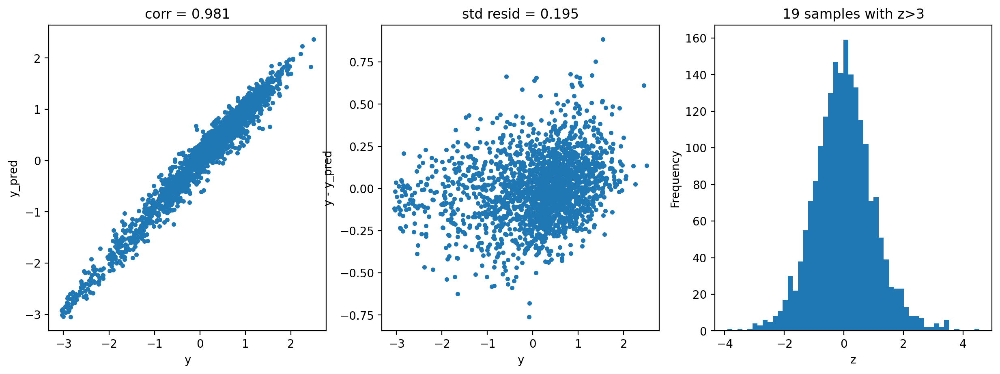

In [31]:
model = 'XGB'
opt_models[model] = XGBRegressor()

param_grid = {'n_estimators':[100,200,300,400,500],
              'max_depth':[1,2,3],
             }

opt_models[model], cv_score,grid_results = train_model(opt_models[model], 
                                                       param_grid=param_grid, 
                                                       splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

Fitting 5 folds for each of 45 candidates, totalling 225 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 225 out of 225 | elapsed:  5.3min finished


----------------------
RandomForestRegressor(max_features=20, min_samples_split=6, n_estimators=200)
----------------------
score= 0.9804557538110072
rmse= 0.13852367198041732
mse= 0.019188807698938246
cross_val: mean= 0.10261480293681786 , std= 0.00879424669877311


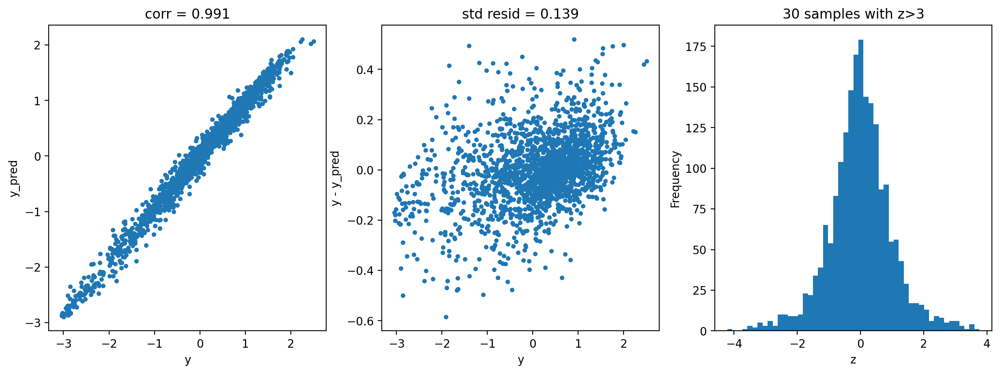

In [32]:
model = 'RandomForest'
opt_models[model] = RandomForestRegressor()

param_grid = {'n_estimators':[100,150,200],
              'max_features':[8,12,16,20,24],
              'min_samples_split':[2,4,6]}

opt_models[model], cv_score, grid_results = train_model(opt_models[model], 
                                                        param_grid=param_grid, 
                                                        splits=5, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

In [33]:
def model_predict(test_data,test_y=[],stack=False):

    i=0
    y_predict_total=np.zeros((test_data.shape[0],))
    
    if stack:
        for model in metal_models.keys():
            y_predict=metal_models[model].predict(test_data)
            y_predict_total+=y_predict
            i+=1
            
            if len(test_y)>0:
                print("{}_mse:".format(model),mean_squared_error(y_predict,test_y))
                
        y_predict_mean=np.round(y_predict_total/i,3)
        
        if len(test_y)>0:
            print("mean_mse:",mean_squared_error(y_predict_mean,test_y))
        
        else:
            y_metal_mean=pd.Series(y_predict_mean)
            return y_metal_mean 
    
    else:
        for model in opt_models.keys():
            if model!="LinearSVR" and model!="KNeighbors":
                y_predict=opt_models[model].predict(test_data)
                y_predict_total+=y_predict
                i+=1
                
            if len(test_y)>0:
                print("{}_mse:".format(model),mean_squared_error(y_predict,test_y))
        
        y_predict_mean=np.round(y_predict_total/i,3)
        
        if len(test_y)>0:
            print("mean_mse:",mean_squared_error(y_predict_mean,test_y))
        
        else:
            y_predict_mean=pd.Series(y_predict_mean)
            
            return y_predict_mean

In [34]:
model_predict(X_valid,y_valid)

Ridge_mse: 0.1376718791278321
Lasso_mse: 0.13786142880041377
ElasticNet_mse: 0.13782685572640616
LinearSVR_mse: 0.13782685572640616
KNeighbors_mse: 0.13782685572640616
GradientBoosting_mse: 0.13485910910624335
XGB_mse: 0.13765297191853748
RandomForest_mse: 0.13976230938366024
mean_mse: 0.12562791926182237


In [72]:
model_predict(X_valid,y_valid)

Ridge_mse: 0.1376718791278321
Lasso_mse: 0.13786142880041377
ElasticNet_mse: 0.13782685572640616
LinearSVR_mse: 0.13782685572640616
KNeighbors_mse: 0.13782685572640616
GradientBoosting_mse: 0.13485910910624335
XGB_mse: 0.13765297191853748
RandomForest_mse: 0.13976230938366024
mean_mse: 0.12562791926182237


In [35]:
def create_stack_features(test_data):
    features={}
    columns=[]
    
    for model in opt_models.keys():
        columns.append(model)
        features[model]=opt_models[model].predict(test_data)
        
    stack_feature=pd.DataFrame(features,columns=columns)
    
    return stack_feature

In [36]:
# load metal data
metal_x_train=create_stack_features(X_t)
metal_y_train=pd.Series(y_t.values)

metal_x_valid=create_stack_features(X_valid)
metal_y_valid=pd.Series(y_valid.values)

metal_x_test=create_stack_features(test)

In [73]:
metal_x_test

,Ridge,Lasso,ElasticNet,LinearSVR,KNeighbors,GradientBoosting,XGB,RandomForest
0,0.203782,0.207656,0.207325,0.144672,0.0695,0.313907,0.326283,0.388049
1,0.218149,0.222353,0.222043,0.173088,0.1593,0.194581,0.120951,0.262771
2,-0.192511,-0.186131,-0.186642,-0.068031,-0.1601,-0.147742,0.018847,-0.082684
3,-0.032256,-0.028246,-0.028587,0.111822,0.0191,0.165688,0.110059,0.227257
4,0.205743,0.213130,0.212499,0.214501,0.0791,0.271660,0.223082,0.353012
...,...,...,...,...,...,...,...,...
1920,-1.416352,-1.375792,-1.379510,-0.315702,-2.7804,-1.759739,-1.628527,-1.997265
1921,-2.505290,-2.455695,-2.460589,-0.411048,-2.7804,-2.586679,-2.634472,-2.576960
1922,-2.304756,-2.280548,-2.282935,-0.554744,-2.7804,-2.567785,-2.536939,-2.545750
1923,-2.348909,-2.327036,-2.329158,-0.537475,-2.7804,-2.560885,-2.543623,-2.518203


In [37]:
# places to store metal models and scores
metal_models = dict()
score_models = pd.DataFrame(columns=['mean','std'])

# no. k-fold splits
splits=5
# no. k-fold iterations
repeats=5

Fitting 25 folds for each of 23 candidates, totalling 575 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


----------------------
Ridge(alpha=0.25)
----------------------
score= 0.9886718339942043
rmse= 0.10546159500355595
mse= 0.011122148020694054
cross_val: mean= 0.011251814896839409 , std= 0.0012996310422623862


[Parallel(n_jobs=1)]: Done 575 out of 575 | elapsed:    2.6s finished


Text(0, 0.5, 'score')

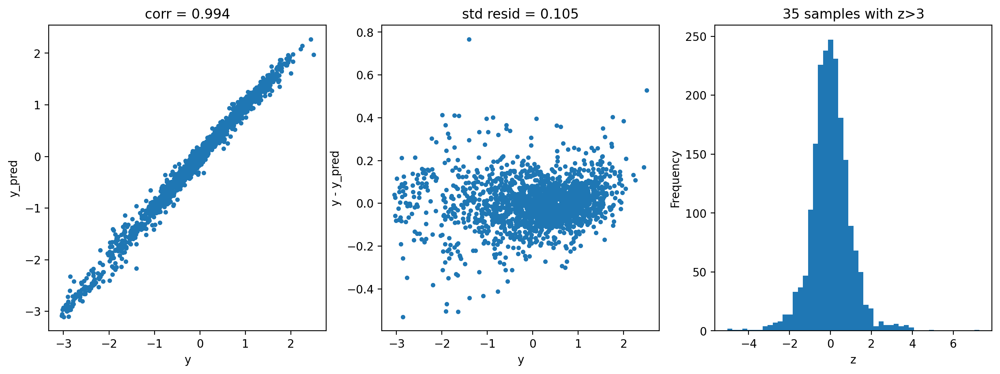

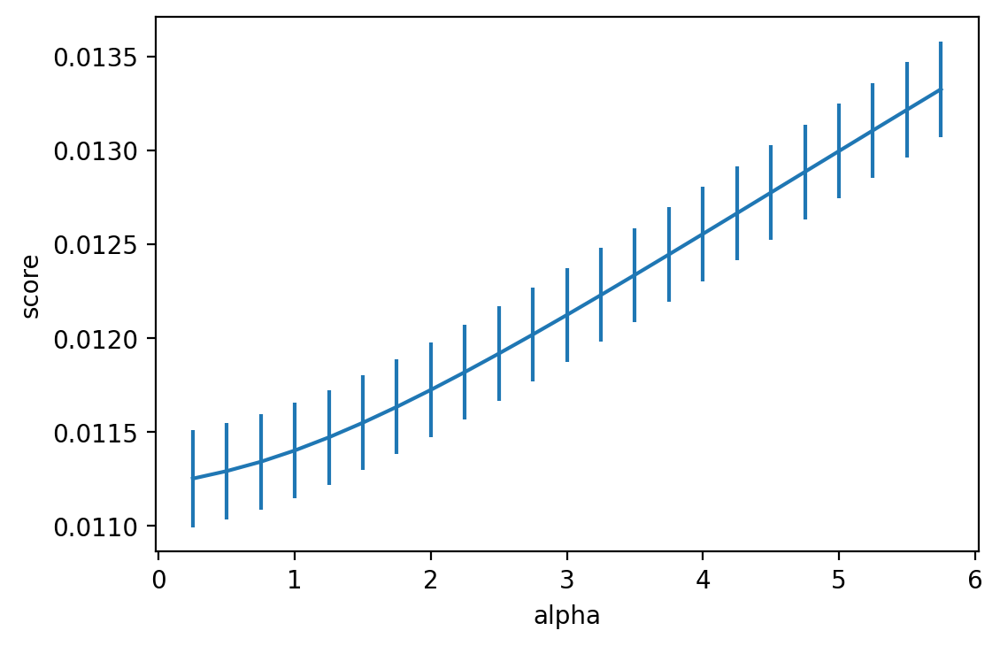

In [38]:
model = 'Ridge'

metal_models[model] = Ridge()
alph_range = np.arange(0.25,6,0.25)
param_grid = {'alpha': alph_range}

metal_models[model],cv_score,grid_results = train_model(metal_models[model], 
                                                        param_grid=param_grid, 
                                                        X=metal_x_train,
                                                        y=metal_y_train,
                                                        splits=splits, repeats=repeats)

cv_score.name = model
score_models = score_models.append(cv_score)

plt.figure()
plt.errorbar(alph_range, 
             abs(grid_results['mean_test_score']),
             abs(grid_results['std_test_score'])/np.sqrt(splits*repeats))

plt.xlabel('alpha')
plt.ylabel('score')

Fitting 25 folds for each of 23 candidates, totalling 575 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


----------------------
Lasso(alpha=0.0001)
----------------------
score= 0.9886552927891064
rmse= 0.10553856357586335
mse= 0.011138388401656544
cross_val: mean= 0.011275105732598463 , std= 0.0013435505988368523


[Parallel(n_jobs=1)]: Done 575 out of 575 | elapsed:    3.7s finished


Text(0, 0.5, 'score')

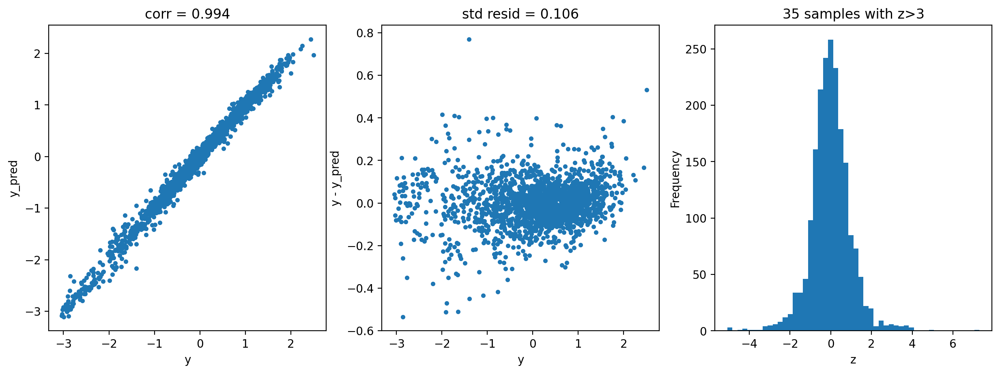

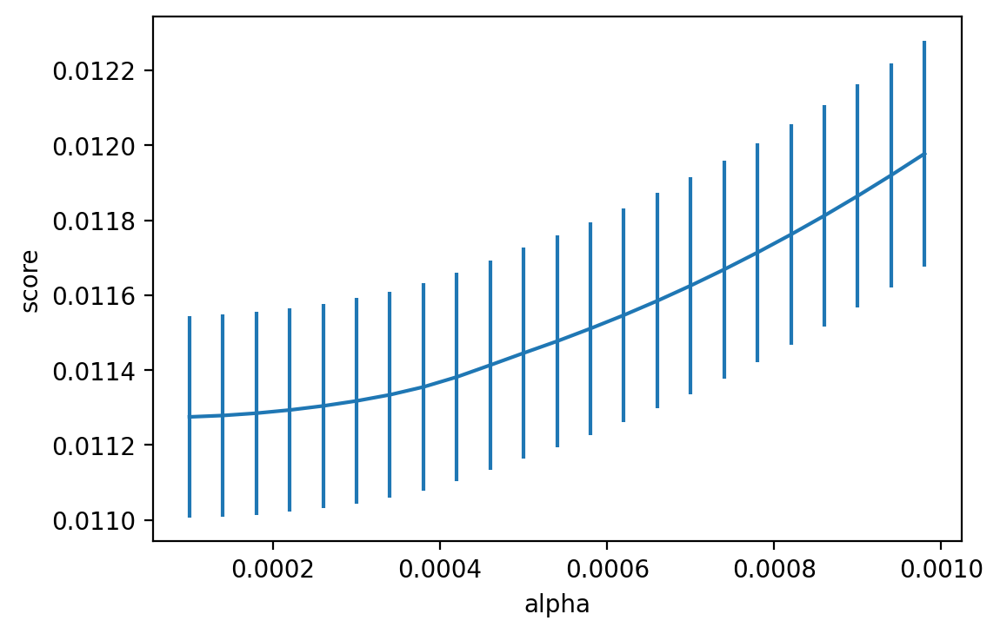

In [39]:
model = 'Lasso'

metal_models[model] = Lasso()
alph_range = np.arange(1e-4,1e-3,4e-5)
param_grid = {'alpha': alph_range}

metal_models[model], cv_score, grid_results = train_model(metal_models[model], 
                                                          param_grid=param_grid, 
                                                          X=metal_x_train,
                                                          y=metal_y_train,
                                                          splits=splits, repeats=repeats)

cv_score.name = model
score_models = score_models.append(cv_score)

plt.figure()
plt.errorbar(alph_range, 
             abs(grid_results['mean_test_score']),
             abs(grid_results['std_test_score'])/np.sqrt(splits*repeats))

plt.xlabel('alpha')
plt.ylabel('score')

Fitting 5 folds for each of 81 candidates, totalling 405 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 405 out of 405 | elapsed:    3.3s finished


----------------------
ElasticNet(alpha=0.0001, l1_ratio=0.1, max_iter=100000)
----------------------
score= 0.9886717173297405
rmse= 0.10546213805654243
mse= 0.011122262563457212
cross_val: mean= 0.011212610248928428 , std= 0.0013602068097450125


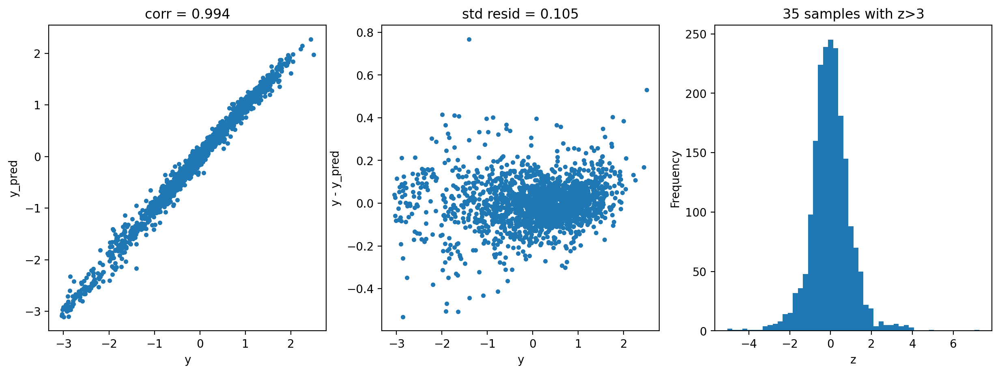

In [40]:
model ='ElasticNet'
metal_models[model] = ElasticNet()

param_grid = {'alpha': np.arange(1e-4,1e-3,1e-4),
              'l1_ratio': np.arange(0.1,1.0,0.1),
              'max_iter':[100000]}

metal_models[model], cv_score, grid_results = train_model(metal_models[model], 
                                                          param_grid=param_grid, 
                                                          X=metal_x_train,
                                                          y=metal_y_train,
                                                          splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

Fitting 5 folds for each of 15 candidates, totalling 75 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed:    5.1s finished


----------------------
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=3,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=0, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)
----------------------
score= 0.9951520487447892
rmse= 0.06899119305957906
mse= 0.004759784719784117
cross_val: mean= 0.013723123318705913 , std= 0.002110678395354269


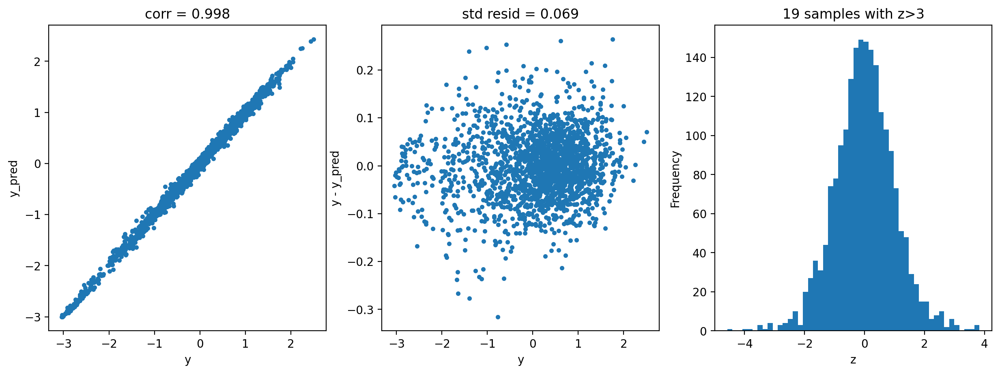

In [42]:
model = 'XGB'
metal_models[model] = XGBRegressor()

param_grid = {'n_estimators':[100,200,300,400,500],
              'max_depth':[1,2,3],
             }

metal_models[model], cv_score,grid_results = train_model(metal_models[model], 
                                                         param_grid=param_grid, 
                                                         X=metal_x_train,
                                                         y=metal_y_train,
                                                         splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

Fitting 5 folds for each of 27 candidates, totalling 135 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 135 out of 135 | elapsed:   58.5s finished


----------------------
GradientBoostingRegressor(min_samples_split=7, n_estimators=350)
----------------------
score= 0.9962077992122786
rmse= 0.0610183128182118
mse= 0.0037232344991811554
cross_val: mean= 0.012876442117974146 , std= 0.0008423989343955402


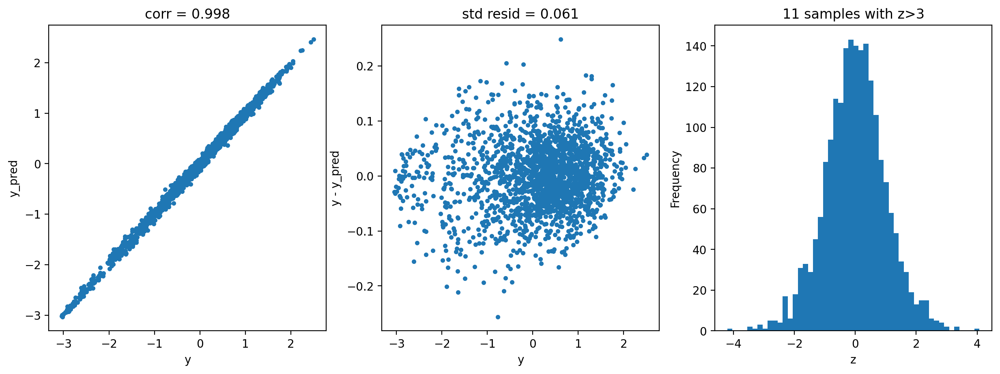

In [43]:
model = 'GradientBoosting'
metal_models[model] = GradientBoostingRegressor()

param_grid = {'n_estimators':[150,250,350],
              'max_depth':[1,2,3],
              'min_samples_split':[5,6,7]}

metal_models[model], cv_score, grid_results = train_model(metal_models[model], 
                                                          param_grid=param_grid, 
                                                          X=metal_x_train,
                                                          y=metal_y_train,
                                                          splits=splits, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

Fitting 5 folds for each of 36 candidates, totalling 180 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 180 out of 180 | elapsed:  1.4min finished


----------------------
RandomForestRegressor(max_features=5, n_estimators=150)
----------------------
score= 0.9981769925811887
rmse= 0.04230666104674865
mse= 0.001789853568924481
cross_val: mean= 0.013592497303284217 , std= 0.0004350745120992508


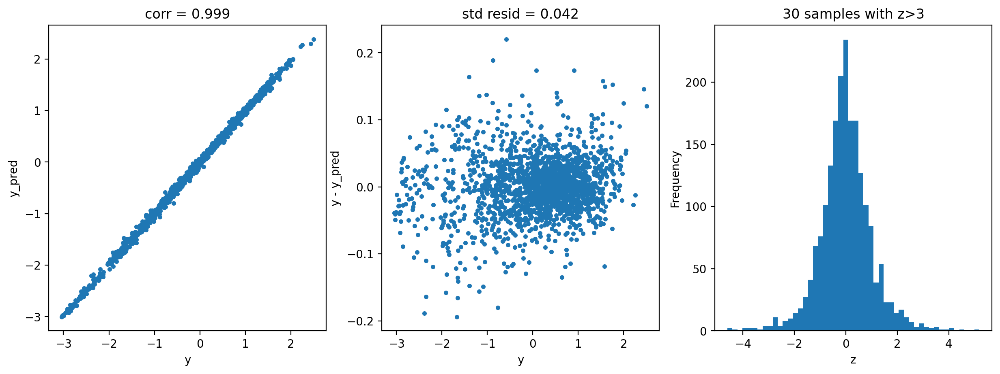

In [44]:
model = 'RandomForest'
metal_models[model] = RandomForestRegressor()

param_grid = {'n_estimators':[100,150,200],
              'max_features':[2,3,4,5],
              'min_samples_split':[2,4,6]}

metal_models[model], cv_score, grid_results = train_model(metal_models[model], 
                                                          param_grid=param_grid,  
                                                          X=metal_x_train,
                                                          y=metal_y_train,
                                                          splits=5, repeats=1)

cv_score.name = model
score_models = score_models.append(cv_score)

In [45]:
model_predict(metal_x_valid, metal_y_valid, stack=True)

Ridge_mse: 0.15380497213951888
Lasso_mse: 0.15401223104178818
ElasticNet_mse: 0.15391639838925852
XGB_mse: 0.15231826542586083
GradientBoosting_mse: 0.15190998229834948
RandomForest_mse: 0.14771102619151608
mean_mse: 0.15033071395617073


In [47]:
predict_result = model_predict(test)
predict_result.to_csv('0.095.txt', index=False, header=False)

test_feature = create_stack_features(test)
predict_result = model_predict(test_feature, stack=True)
predict_result.to_csv('0.095stacking.txt', index=False, header=False)

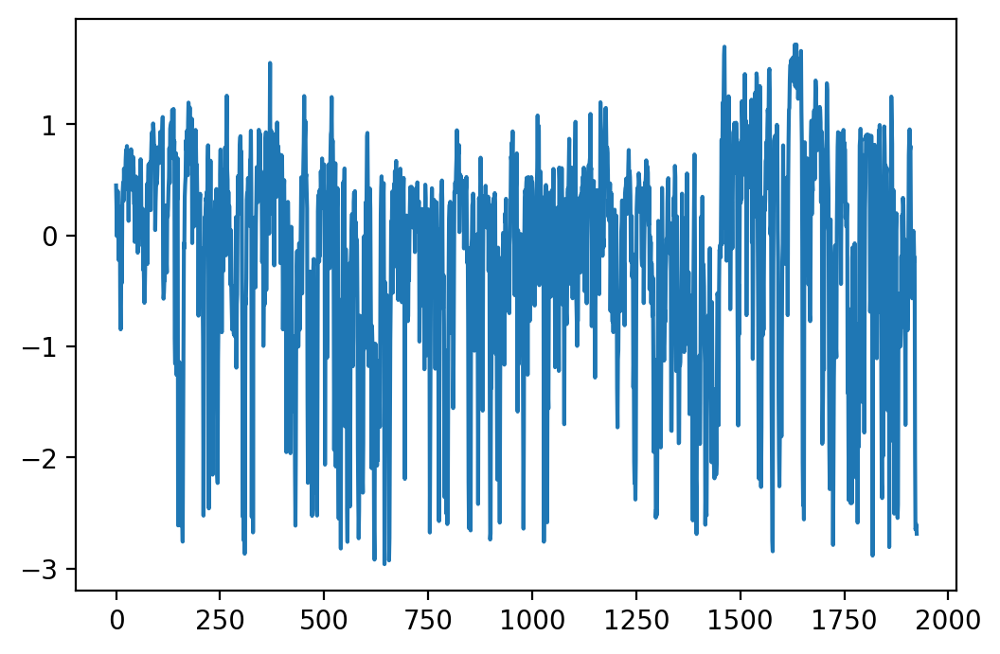

In [66]:
plt.plot(predict_result)

In [63]:
data_train

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V30,V31,V32,V33,V34,V35,V36,V37,target,origin
0,0.566,0.016,-0.143,0.407,0.452,-0.901,-1.812,-2.360,-0.436,-2.114,...,0.109,-0.615,0.327,-4.627,-4.789,-5.101,-2.608,-3.508,0.175,train
1,0.968,0.437,0.066,0.566,0.194,-0.893,-1.566,-2.360,0.332,-2.114,...,0.124,0.032,0.600,-0.843,0.160,0.364,-0.335,-0.730,0.676,train
2,1.013,0.568,0.235,0.370,0.112,-0.797,-1.367,-2.360,0.396,-2.114,...,0.361,0.277,-0.116,-0.843,0.160,0.364,0.765,-0.589,0.633,train
3,0.733,0.368,0.283,0.165,0.599,-0.679,-1.200,-2.086,0.403,-2.114,...,0.417,0.279,0.603,-0.843,-0.065,0.364,0.333,-0.112,0.206,train
4,0.684,0.638,0.260,0.209,0.337,-0.454,-1.073,-2.086,0.314,-2.114,...,1.078,0.328,0.418,-0.843,-0.215,0.364,-0.280,-0.028,0.384,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2883,0.190,-0.025,-0.138,0.161,0.600,-0.212,0.757,0.584,-0.026,0.904,...,-0.208,0.809,-0.173,0.247,-0.027,-0.349,0.576,0.686,0.235,train
2884,0.507,0.557,0.296,0.183,0.530,-0.237,0.749,0.584,0.537,0.904,...,-0.287,0.465,-0.310,0.763,0.498,-0.349,-0.615,-0.380,1.042,train
2885,-0.394,-0.721,-0.485,0.084,0.136,0.034,0.655,0.614,-0.818,0.904,...,-0.179,0.268,0.552,0.763,0.498,-0.349,0.951,0.748,0.005,train
2886,-0.219,-0.282,-0.344,-0.049,0.449,-0.140,0.560,0.583,-0.596,0.904,...,1.061,-0.051,1.023,0.878,0.610,-0.230,-0.301,0.555,0.350,train


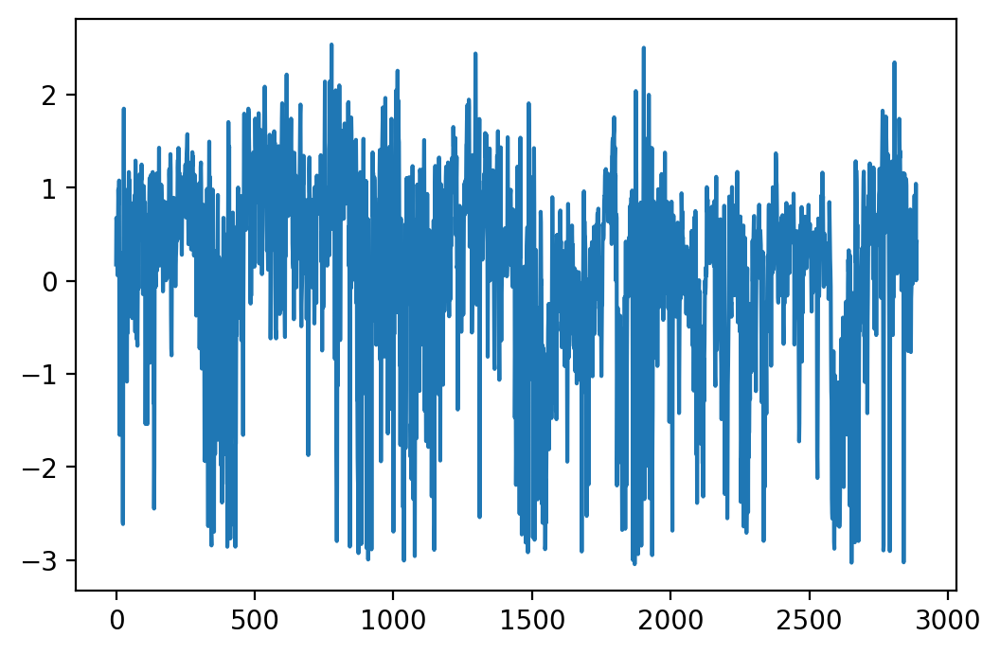

In [65]:
plt.plot(data_all.target[data_all['origin']=='train'].values)

In [57]:
data_all[data_all["origin"]=="test"].reset_index(drop=True)

,V0,V1,V2,V3,V4,V6,V7,V8,V10,V12,...,V30,V31,V32,V33,V34,V35,V36,V37,target,origin
0,3.776075,7.069312,0.893000,0.800397,1.178315,6.276008,8.630500,5.173098,0.364102,1.725493,...,1.748218,21.107983,2.453311,0.539188,0.574503,7.279759,0.324214,0.552931,NaN,test
1,3.394817,7.476449,0.886219,0.800397,1.084765,6.097243,8.379541,4.381098,0.367358,1.794980,...,2.164438,23.641832,2.162433,0.486043,0.545369,7.916062,0.377974,0.516601,NaN,test
2,2.903231,5.602648,0.866625,0.825062,1.022993,6.091637,8.379541,4.185449,0.525979,1.627825,...,1.782136,23.924253,2.241417,0.482897,0.543448,7.916062,0.520486,0.575907,NaN,test
3,3.319038,6.761318,0.882530,0.826367,0.979641,6.060877,8.426660,4.661140,0.361666,1.513929,...,2.590345,23.169684,2.659310,0.476720,0.535779,7.916062,0.305358,0.553313,NaN,test
4,3.654839,7.246254,1.031245,0.826367,1.030555,5.878964,8.396650,4.973238,0.417456,1.500806,...,1.933972,26.119391,1.833670,0.476720,0.535779,7.916062,0.409456,0.438546,NaN,test
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1920,1.507318,2.366075,0.192182,0.700533,1.179061,0.138338,0.043709,0.440800,0.004467,1.754458,...,0.002497,0.448108,0.001087,0.353644,0.460152,2.996210,0.005636,0.579449,NaN,test
1921,0.607637,0.591671,0.100980,0.552034,0.623189,0.122522,0.084880,0.334212,0.008009,0.766166,...,1.285751,0.000000,1.206656,0.353644,0.460152,2.996210,0.005636,0.656833,NaN,test
1922,0.648457,0.535177,0.137667,0.705981,0.653005,0.308269,0.291171,0.133988,0.007462,1.000486,...,1.800831,0.324084,1.913673,0.283510,0.369879,3.987778,0.008216,0.705772,NaN,test
1923,0.625626,0.496193,0.160569,0.638362,0.653539,0.497144,0.493672,0.238140,0.003246,0.862510,...,2.671518,0.722675,2.288979,0.305179,0.379680,3.987778,0.007570,0.683533,NaN,test


In [60]:
data_all.head()

,V0,V1,V2,V3,V4,V6,V7,V8,V10,V12,...,V30,V31,V32,V33,V34,V35,V36,V37,target,origin
0,4.147084,5.841184,0.918479,0.921088,1.205738,1.864358,1.568184,3.799373,0.262782,1.495579,...,1.788352,15.555190,1.958944,0.000000,0.000000,0.519843,0.000000,0.018284,0.175,train
1,4.988271,7.279840,0.984897,0.964538,1.110508,2.148236,1.568184,5.377114,0.493786,1.463960,...,1.800049,21.939735,2.208823,0.390305,0.598083,9.178637,0.369734,0.407834,0.676,train
2,5.090224,7.783637,1.040170,0.911078,1.081218,2.401542,1.568184,5.529584,0.655989,1.496101,...,1.992162,24.904403,1.595903,0.390305,0.598083,9.178637,0.611879,0.426451,0.633,train
3,4.481728,7.025646,1.056127,0.856314,1.262126,2.631664,1.888754,5.546472,0.454651,1.526601,...,2.039607,24.929995,2.211686,0.390305,0.566738,9.178637,0.511483,0.488736,0.206,train
4,4.381416,8.064594,1.048467,0.867969,1.162709,2.818015,1.888754,5.334858,0.398723,1.642254,...,2.663214,25.564336,2.039935,0.390305,0.546056,9.178637,0.380802,0.499597,0.384,train
